In [1]:
import pandas as pd
import geopandas as gpd
import folium
import pprint

GO TO THE ROOT FOLDER WHERE THERE ARE FOLDERS FOR:
- src
- JupNB

_Chech with `pwd`_

In [2]:
cd "C:\\Code\\ditto_v2"

C:\Code\ditto_v2


c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [3]:
pwd

'C:\\Code\\ditto_v2'

In [4]:
import sys
sys.path.append('src/functionality/')

In [5]:
import f_verwaltungs_gebiete
import f_plz
import f_maps

# FUNCTIONS TO EXTRACT

In [6]:
def conv_col_to_string(pdf, l_cols:str, col_addendum:str=''):
    for col in l_cols:
        col_name = f'{col}{col_addendum}'
        pdf[col_name] = pdf[col_name].astype('str')
    return pdf

In [7]:
def clean_gdf(l_gdf: list, is_sanity_checked:bool=True) -> dict :
    d_gdf={}
    for name,gdf in kvp_gdf_adm:
        print(f'Cleaning gdf=[{name}], shape=[{gdf.shape}]')
        gdf_clean = f_verwaltungs_gebiete.pimp_gdf(gdf)

        if (is_sanity_checked):
            print(f'Checking sanity gdf=[{name}], shape=[{gdf.shape}]')
            maps.check_sanity_gdf_geometry(gdf)
        
        print(f'Adding gdf [{name}] to d_gdf\n')
        d_gdf[name] = gdf
    return d_gdf

In [8]:
def gen_gdf_filt(
    d_gdf : dict,
    l_filt_list : list,
    # gdf_level: list, 
    # gdf_filt_field: list,
    # gdf_filt_value: list,
    is_logging: bool = False
) -> list:
    l_gdf_filt = []
    for filt in l_filt_list:
        gdf_level = filt[0]
        gdf   = d_gdf[gdf_level]
        field = filt[1]
        val   = filt[2]
        if is_logging:
            print(f'Filter =[{filt}]')
            print(f'  Filtering level=[{gdf_level}], field=[{field}], value=[{val}]')
            print(f'  gdf Shape=[{gdf.shape}]')

        filt_cond = gdf[field] == val
        gdf_filt = gdf[filt_cond]
        l_gdf_filt.append(gdf_filt)
        if is_logging:
            print(f'  Shape filtered gdf =[{gdf_filt.shape}]')
            print(f'  Shape list of gdfs = [{len(l_gdf_filt)}]\n')
    return l_gdf_filt

    # l_gdf_filt = []
    # for gdf,field,val in zip(gdf_level, gdf_filt_field,gdf_filt_value):
    #     if is_logging:
    #         print(f'Filtering level=[{gdf_level}], field=[{field}], value=[{val}]')
    #     filt_cond = gdf[field] == val
    #     gdf_filt = gdf[filt_cond]
    #     l_gdf_filt.append(gdf_filt)
    # return l_gdf_filt

In [9]:
def gen_pdf_plz_data(path: str) -> [pd.DataFrame, pd.DataFrame]:
    ## CSVs

    pdf_ort = pd.read_csv(path_plz_ags_lkr_lan)
    print (f'`pdf_ort` generated')
    print(pdf_ort.shape)
    
    # pdf_plz2_regionen = pd.read_csv(
    #     path_destatis_plz2_reg, 
    #     header=[0,1], encoding='latin1'
    # )
    # print (f'`pdf_plz2_regionen` generated from path=[{path_plz_ags_lkr_lan}]')
    
    
    
    #### Group and agg ```pdf_ort``` to get ```pdf_ort_sum```
    ## Parsing 'AGS' type to 'str' with 8 digits
    pdf_ort['ags'] = pdf_ort['ags'].astype('str')
    pdf_ort['ags'] = pdf_ort['ags'].str.zfill(8)
    # pdf_ort_sum = pdf_ort_sum.astype('str')#
    
    # pdf_ort['landkreis'] = pdf_ort['landkreis'].fillna(value={'landkreis': None})#, inplace=True)
    
    # pdf_ort.drop_duplicates()
    pdf_ort.sort_values(by='landkreis')
    
    
    ## GROUPBY UNIQUE FIELDS ('OSM_ID, 'AGS', 'ort')
    l_by = ['ags', 'osm_id', 'ort', ]#'landkreis', 'bundesland']
    
    d_agg = {
        'plz':         ['nunique','unique'],
        'landkreis' :  ['unique'],
        'bundesland' : ['unique']
    }
    
    pdf_ort_sum = f_plz.plz_group_agg(pdf=pdf_ort, l_by = l_by, d_agg=d_agg)
    
    
    pdf_ort_sum = pdf_ort_sum.rename(columns={'ags': 'AGS'})#, inplace=True)
    pdf_ort_sum = pdf_ort_sum.fillna(value={'landkreis_unique': 0})#, inplace=True)
    
    pdf_ort_sum.sort_values(by='plz_nunique', ascending=False)
    # pdf_ort_sum#.head(5)
    print (f'`pdf_ort_sum` generated')
    print(pdf_ort_sum.shape)

    return [pdf_ort, pdf_ort_sum]

In [10]:
def gen_geojson_adm1_to_adm6(d_filt, d_gdf, is_logging:bool=False):
    fm = folium.Map(tiles='cartodbpositron')
    
    for k,v in d_filt['mode'].items():
        if is_logging:
            print(f'key={k}')
            
        gdf_adm  = d_gdf[k]
        gdf_filt = gdf_adm
        for filt_list_tuples in v['filt_cond']:
            if filt_list_tuples:
                if is_logging:
                    print(filt_list_tuples)
                for filt_col,filt_val in filt_list_tuples:                
                    if is_logging:
                        print(f' shape before={gdf_filt.shape}')
                        
                    if is_logging:
                        print(f'  filt_col={filt_col}\n  filt_val={filt_val}')
        
                    gdf_filt = gdf_filt[gdf_filt[filt_col] == filt_val]
                    
                    if is_logging:
                        print(f'  shape after={gdf_filt.shape}')
        
                    if gdf_filt.shape[0] == 0:
                        print(f'Error, invalid filter value shape[{k},({filt_col},{filt_val})]=0')
                        raise ValueError(f'Error, invalid filter value [{k}, ({filt_col},{filt_val})]')
        
                if gdf_filt is not None:
                    if is_logging:
                        print(f'  Adding fg [{filt_col},{filt_val}] to folium map')
                    fg = maps.get_folium_featuregroup( 
                        pdf = gdf_filt,
                        fg_name = f'{k} ({filt_list_tuples}) [shape={gdf_filt.shape[0]}]',
                        fields  = list(dict_tooltip[k].keys()),
                        aliases = list(dict_tooltip[k].values()),
                        is_tooltip = True,  # does NOT add weight to map
                    )
                    fg.add_to(fm)
                    # Reset filter to ADM level
                    gdf_filt = gdf_adm

                    
            if is_logging:
                print(f' {k} FINISHED!')

    if is_logging:
        print('Adding LayerControl')
    fm.add_child(
        folium.LayerControl(
            position='topright',
            collapsed=False
        )
    )

    if is_logging:
        print('Adding Fullscreen')
    fm.add_child(
        folium.plugins.Fullscreen(
            position='topleft',
            title='Expand me',
            title_cancel='Exit me',
            force_separate_button=True
        )
    )

    if is_logging:
        print('Adding Fitting bounds')
    fm.fit_bounds(
        fm.get_bounds()
    )

    return fm

In [11]:
def load_gdf_plz(l_gdf_plz:list, is_sanity_checked:bool=True) -> dict :
    d_plz = dict()
    for name,path in kvp_gdf_plz:
        print(f'Processing [{name}] with path=[{path}]')

        # if name == 'ort':
            
        if name == 'plz2_reg':
            gdf = pd.read_csv(
                path, 
                header=[0,1], encoding='latin1'
            )
            print (f'`pdf_plz2_regionen` generated from path=[{path}]')
        else:
            gdf = gpd.read_file(path)
            if name == 'plz2':
                # gdf = gdf_plz2.drop([0,1])
                gdf['plz'] = gdf['plz'].astype('int').astype('str')
                gdf['plz'] = gdf['plz'].str.zfill(2)
        
        if (is_sanity_checked):
            print(f'Checking sanity [{name}] with shape=[{gdf.shape}]')
            maps.check_sanity_gdf_geometry(gdf)
        
        print(f'Adding gdf [{name}] to d_gdf[{name}]')
        d_plz[name] = gdf
    
    return d_plz

In [12]:
def gen_gdf_adm55(gdf_adm5, pdf_ort_sum, is_sanity_checked:bool=True) :
    
    gdf_adm55 = pd.merge(
        gdf_adm5,
        pdf_ort_sum,
        on='AGS',
        # how='left'
    )
    max_shape = max([gdf_adm5.shape[0],pdf_ort_sum.shape[0]])
    gdf55_shape = gdf_adm55.shape[0]
    
    print(f'gdf_adm5.shape={gdf_adm5.shape}')
    print(f'pdf_ort_sum.shape={pdf_ort_sum.shape}')
    print(f'Unmatched AGS=[{max_shape-gdf55_shape}]')
    
    print('\nMerge was successful!!!')
    print(f'gdf_adm55.shape={gdf55_shape}')
    
    # ## GROUPBY UNIQUE FIELDS ('OSM_ID, 'AGS', 'ort')
    # l_by = ['ags', 'osm_id', 'ort', ]#'landkreis', 'bundesland']
    
    d_agg = {
        'plz':         ['nunique','unique'],
        'landkreis' :  ['unique'],
        'bundesland' : ['unique']
    }
    
    ## Converting columns with lists to type 'str' so they can be serialised and used as geoJson
    l_cols_to_str = list(d_agg.keys())
    col_addendum = '_unique'
    gdf_adm55 = conv_col_to_string(gdf_adm55, l_cols=l_cols_to_str, col_addendum=col_addendum)
    
    print('\ngdf_adm55')
    if (is_sanity_checked):
        maps.check_sanity_gdf_geometry(gdf_adm55)
    gdf_adm55.sort_values('plz_nunique', ascending=False)
    
    return gdf_adm55
    
def gen_pdf_adm_exp(gdf_adm, col_explode:str='plz') :

    ## Explode pdf based in 'plz_unique'
    # col_explode = 'plz'
    
    gdf_adm55_exp = gdf_adm.copy()
    gdf_adm55_exp[col_explode] = gdf_adm55_exp['plz_unique'].str.replace('[', '').str.replace(']', '').str.split(' ')
    
    pdf_adm55_exp = pd.DataFrame(gdf_adm55_exp)
    # pdf_adm55_exp.head()
    pdf_adm55_exp = pdf_adm55_exp.rename(columns={'geometry':'geometry_adm5'})
    pdf_adm55_exp['geometry_adm5'] = pdf_adm55_exp['geometry_adm5'].astype('str')
    pdf_adm55_exp =pdf_adm55_exp.explode(col_explode)
    
    print('\npdf_adm55_exp Generated')
    print(f'original shape = [{gdf_adm.shape[0]}]')
    print(f'exploded shape = [{pdf_adm55_exp.shape[0]}]')
        
    return pdf_adm55_exp

def gen_gdf_adm_plz(gdf_adm_exp, gdf_plz, col_merge:str='plz', is_sanity_checked:bool=True) :

    # col_merge = 'plz'
    # gdf_adm6 = pd.merge(
    #     d_gdf['plz5'],
    #     pdf_adm55_exp,
    #     on=col_merge)
    gdf_adm_plz = pd.merge(
        gdf_plz,
        gdf_adm_exp,
        on=col_merge)
    
    print(f'Shape ADM = [{gdf_adm_exp.shape[0]}]')
    print(f'Shape PLZ = [{gdf_plz.shape[0]}]')
    print(f'merge on column=[{col_merge}]')
    print(f'  Shape ADM+PLZ = [{gdf_adm_plz.shape[0]} ADM+PLZ]')

    gdf_adm_plz['plz_unique'] = gdf_adm_plz['plz_unique'].astype('str')

    if (is_sanity_checked):
        maps.check_sanity_gdf_geometry(gdf_adm_plz)

    return gdf_adm_plz

# 0. INPUT SELECTION

## 0.1. INPUT FOR PROCESSING

In [42]:
logging = True

In [43]:
## VG
parent_folder = 'VG_VerwaltungsGebiete'
date_YYYYMMDD = 20221231
crs='EPSG:25832'  # ETRS89, used by BKG

## GEOJSONs
path_plz1 = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-1stellig.geojson'
path_plz2 = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-2stellig.geojson'
path_plz3 = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-3stellig.geojson'
path_plz5 = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-5stellig.geojson'

## CSVs
path_destatis_plz2_reg = 'DESTATIS/PLZ/20221231/21_Postleitregionen_20221231.csv'
path_plz_latlon_ewz   = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz_einwohner.csv'
path_plz_ags_lkr_lan  = 'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/zuordnung_plz_ort.csv'

## logging
is_logging = True

In [44]:
## FILT info

dict_id_bundeslaender = {
    1:  'Schleswig-Holstein',
    2:  'Hamburg',
    3:  'Niedersachsen',
    4:  'Bremen',
    5:  'Nordrhein-Westfalen',
    6:  'Hessen',
    7:  'Rheinland-Pfalz',
    8:  'Baden-Württemberg',
    9:  'Bayern',
    10: 'Saarland',
    11: 'Berlin',
    12: 'Brandenburg',	
    13: 'Mecklenburg-Vorpommern',
    14: 'Sachsen',
    15: 'Sachsen-Anhalt',
    16: 'Thüringen'
}

dict_bundeslaender_id = {
    'Schleswig-Holstein': 1,
    'Hamburg': 2,
    'Niedersachsen': 3,
    'Bremen': 4,
    'Nordrhein-Westfalen': 5,
    'Hessen': 6,
    'Rheinland-Pfalz': 7,
    'Baden-Württemberg': 8,
    'Bayern': 9,
    'Saarland': 10,
    'Berlin': 11,
    'Brandenburg': 12,
    'Mecklenburg-Vorpommern': 13,
    'Sachsen': 14,
    'Sachsen-Anhalt': 15,
    'Thüringen': 16
}

## 0.2. INPUT FOR MAPS

In [45]:
first_color = 'green'
second_color = 'yellow'
third_color = 'red'
col_pdf_breakdown ='color'

In [46]:
sel_column_BVD = 'BVD'
legend_str_BVD = 'Bevölkerungsdichte [Ew/km2]'#'Population density'
dict_lims_BVD = {   ## Bevölkerungsdicht [Ew/km2]
    'ADM1' : {
        'lim1' : 100,   
        'lim2' : 200 },
    'ADM2' : {
        'lim1' : 100,   
        'lim2' : 200 },
    'ADM3' : {
        'lim1' : 100,   	
        'lim2' : 200 }, 
    'ADM4' : {
        'lim1' : 100,    	
        'lim2' : 500 }, 
    'ADM45' : {
        'lim1' : 500,    
        'lim2' : 1000 },  
    'ADM5' : {
        'lim1' : 500,
        'lim2' : 1000 },   
    'ADM6' : {
        'lim1' : 500,
        'lim2' : 1000 },  
}

# Landstadt: 2.000–5.000 Einwohner
# Kleinstadt: 5.000–20.000 Einwohner
# Mittelstadt: 20.000–100.000 Einwohner
# Großstadt: mehr als 100.000 Einwohner

legend_str_EWZ = 'Population'
sel_column_EWZ = 'EWZ'
dict_lims_EWZ = {  ## Einwohnerzahl [Ew]
    'ADM1' : {
        'lim1' : 10000000,   # 10M	
        'lim2' : 50000000 }, # 50M
    'ADM2' : {
        'lim1' : 3000000,   # 3M	
        'lim2' : 8000000 }, # 8M
    'ADM3' : {
        'lim1' : 1000000,   # 100K	
        'lim2' : 5000000 }, # 500K
    'ADM4' : {
        'lim1' : 100000,   # 100K	
        'lim2' : 500000 }, # 500K
    'ADM45' : {
        'lim1' : 20000,    # 20K
        'lim2' : 100000 }, # 100K
    'ADM5' : {
        'lim1' : 20000,    # 20K
        'lim2' : 100000 }, # 100K
    'ADM6' : {
        'lim1' : 20000,    # 20K
        'lim2' : 100000 }, # 100K
}

In [47]:
# # mode = 'STA'   # ADM=1
# # sta = 'DE' # NOT CURRENTLY A FIELD FOR THIS

# # mode = 'LAN'   # ADM=2
# lan = '11'   # Format (d:2d), Berlin [1 BEZ=0, 1 VWG=0000, 1 GEM=000, 190 PLZ]

# # mode = 'BEZ'   # ADM=3
# # bez = ''

# # mode = 'GVW'   # ADM=4
# gvw = '' 

# # mode = 'GEM'   # ADM=5
# gem = ''
# ort = 'Friedrichshafen'  # Friedrichshafen, [1 GEM, 3 PLZ]

# # mode = 'PLZ'   # ADM=6
# plz = 88422  # 88422, Bad Buchau, [9 GEM, 1 PLZ]

# # mode = 'ARS'   # ADM N/A
# ars = '064370006006'  # 064370006006, Erbach [1 GEM, 1 PLZ]

# # mode = 'AGS'   # ADM N/A
# ags = '06437006'      # 06437006, Erbach [1 GEM, 1 PLZ]

# # mode = 'STA'   # ADM=1
# # mode = 'LAN'   # ADM=2
# # mode = 'BEZ'   # ADM=3
# # mode = 'GVW'   # ADM=4
# # mode = 'GEM'   # ADM=5
# mode = 'PLZ'   # ADM=6
# # mode = 'ARS'   # ADM N/A
# # mode = 'AGS'   # ADM N/A

In [48]:
# if mode == 'STA': # ADM=1
#     l_filt_cond = ['DE', sta]

# elif mode == 'LAN': # ADM=2
#     l_filt_cond = ['SN_L', lan]
#     mode_val = lan
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['SN_L']==bl]
#     # gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
#     # red_id = lan

# elif mode == 'BEZ': # ADM=3
#     l_filt_cond = ['SN_R', bez]
#     mode_val = bez

# elif mode == 'GWV': # ADM=4
#     l_filt_cond = ['SN_V1'+'SN_V2', gwv]
#     mode_val = gwv

# elif mode == 'GEM': # ADM=5
#     l_filt_cond = ['SN_G', gem]
#     mode_val = gem
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['ort']=='Friedrichshafen']
#     # gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
#     # red_id = ort

# elif mode == 'PLZ': # ADM=6
#     l_filt_cond = ['plz', str(plz)]
#     mode_val = plz
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# elif mode == 'ARS': # ADM N/A
#     l_filt_cond = ['ARS_0', ars]
#     mode_val = ars
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# elif mode == 'AGS': # ADM N/A
#     l_filt_cond = ['AGS_0', ags]
#     mode_val = ags
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# else:
#     print(f'  FAIL -> invalid mode [{mode}]')
#     raise ValueError(f'Error, invalid mode [{mode}]')


d_filt = {
    'active_modes' : [
        # 'STA',   # ADM=1
        # 'LAN',   # ADM=2
        # 'BEZ',   # ADM=3
        # 'GVW',   # ADM=4
        # 'GEM',   # ADM=5
        'PLZ',   # ADM=6
        # 'ARS',   # ADM N/A
        # 'AGS',   # ADM N/A
    ],
    'mode' : {
        'ADM1' : {   # ADM=1, STA
            'filt_level'  : 1,
            'filt_fields' : ['CC'], # Country Code
            'filt_cond'   : [[
                # ('CC', 'DE'),       # key in gdf_adm1
            ]]
        },
        'ADM2' : {   # ADM=2, LAN
            'filt_level'  : 2,
            'filt_fields' : ['CC, SN_L'], # Country Code
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09')     # gdf_adm2, SN_L, format (d:2d), format (d:2d), [z.B. LAN='09', GEN = 'Bayern']
            ]]
        },
        'ADM3' : {   # ADM=3, REG. BEZ.
            'filt_level'  : 3,
            'filt_fields' : ['CC, SN_L', 'SN_R'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d), [z.B. LAN='09', GEN = 'Bayern']
                # ('SN_L' ,str(dict_bundeslaender_id['Bayern']).zfill(2) ),
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d), [z.B. BEZ='7', GEN = 'Schwaben'] 
            ]]
        },
        'ADM4' : {   # ADM=4, KREISE
            'filt_level'  : 4,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
            ]]
        },
        'ADM45' : {   # ADM=45, GEMEINDEVERWALTUNG
            'filt_level'  : 45,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
            ]]
        },
        'ADM5' : {   # ADM=5, GEMEINDE
            'filt_level'  : 5,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d) [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
            ]]
        },
        'PLZ5' : {   # ADM=6, PLZ
            'filt_level'  : 6,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G', 'PLZ'],
            'filt_cond'   : [
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d)   [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
                # ('plz', '88131')     # gdm_adm6, plz, format (d:5d)    [z.B. plz=88131, GEN = 'Lindau (Bodensee)']
                [    ('ort', 'Stuttgart')],
                [    ('ort', 'Berlin')],
                [    ('ort', 'Ulm')],
                [    ('plz', '88131')],
            ]
        },
        'ARS' : {   # ADM N/A, 12-stellige UNIQUE ID for GERMANY
            'filt_level'  : 12,
            'filt_fields' : ['ARS'],
            'filt_cond'   : [[
                ('ARS', '097760116116')     #format (d:12d)    [z.B. plz=Erbach [1 GEM, 1 PLZ]]]
            ]]
        },
        'AGS' : {   # ADM N/A, 9-stellige UNIQUE ID for GERMANY
            'filt_level'  : 9,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G', 'PLZ'],
            'filt_cond'   : [[
                # ('ARS', '06437006')     #format (d:9d)    [z.B. plz=Erbach [1 GEM, 1 PLZ]]]
            ]]
        },
    }
}

    
# print(f'd_filt={d_filt}')
pprint.pprint(d_filt)
# print('  PASS -> Dictionary FILTER correctly selected\n')
# gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]


# gdf_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
# print(f'gdf_filt.shape={gdf_filt.shape}\n')
# print(gdf_adm6.columns)
# gdf_filt#.loc[0]

{'active_modes': ['PLZ'],
 'mode': {'ADM1': {'filt_cond': [[]], 'filt_fields': ['CC'], 'filt_level': 1},
          'ADM2': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L'],
                   'filt_level': 2},
          'ADM3': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L', 'SN_R'],
                   'filt_level': 3},
          'ADM4': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L', 'SN_R', 'SN_K'],
                   'filt_level': 4},
          'ADM45': {'filt_cond': [[]],
                    'filt_fields': ['CC, SN_L',
                                    'SN_R',
                                    'SN_K',
                                    'SN_V1',
                                    'SN_V2'],
                    'filt_level': 45},
          'ADM5': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L',
                                   'SN_R',
                                   'SN_K',
                          

In [49]:
dict_tooltip_VG = {
    'ARS' : 'Amtliche Regional Schlüssel',
    'BEZ' : 'Bezeichnung:',
    'GEN' : 'Geografischer Name',
    'EWZ' : 'Einwohnerzahl:',
    'KFL' : 'Fläche [km2]:',
    'BVD' : 'Bevölkerungsdichte [Ew/qkm]'
}

dict_tooltip_PLZ5 = {
    # 'ARS' : 'Amtliche Regional Schlüssel',
    # 'ort' : 'Bezeichnung:',
    # 'GEN' : 'Geografischer Name',
    'einwohner' : 'Einwohnerzahl:',
    'qkm' : 'Fläche [km2]:',
    # 'BVD' : 'Bevölkerungsdichte [Ew/qkm]'
    'plz' : '5-stellige PLZ ',
    'note': 'Note'
}
dict_tooltip = {
    'ADM1'  : dict_tooltip_VG,
    'ADM2'  : dict_tooltip_VG,
    'ADM3'  : dict_tooltip_VG,
    'ADM4'  : dict_tooltip_VG,
    'ADM45' : dict_tooltip_VG, 
    'ADM5'  : dict_tooltip_VG, 
    'ADM6'  : dict_tooltip_VG, 
    'PLZ5'  : dict_tooltip_PLZ5, 
    'ARS'   : dict_tooltip_VG, 
    'AGS'   : dict_tooltip_VG, 
}
# dict_tooltip

## 0.3. FILT_DATA

In [50]:
# d_gdf = {
#     'ADM1'  : gdf_adm1,  # COUNTRY  / STAAT
#     'ADM2'  : gdf_adm2,  # LAND     / LAND
#     'ADM3'  : gdf_adm3,  # REGION   / REG.BEZIRK
#     'ADM4'  : gdf_adm4,  # DISTRICT / KREIS
#     'ADM45' : gdf_adm45, # ADM UNIT / GEMEINDE VERWALTUNG
#     'ADM5'  : gdf_adm5,  # LOCALITY / GEMEINDE
#     'PLZ5'  : gdf_adm6,  # ZIP CODE / POSTLEITZAHL
#     'ARS'   : gdf_adm6,  # TER.CODE1/ ARS - 12 STELLIG (FUTURE)
#     'AGS'   : gdf_adm6,  # TER.CODE2/ AGS - 9 STELLIG (TO BE DISCONTINUED)
# }

l_filt_list = [
    
    ['ADM5',  'ort', 'Stuttgart'],
    ['ADM6',  'plz', '88131'],
    ['ADM6',  'ort', 'Stuttgart'],
    ['ADM6',  'ARS', '097760116116'],
]


## EXAMPLES
# gdf_adm6[gdf_adm6['ort'] == 'Stuttgart']
# gdf_filt = gdf_adm6[gdf_adm6['plz'] == '88131']
# gdf_filt = gdf_adm6[gdf_adm6['ort'] == 'Stuttgart']
# gdf_filt#.iloc[0]

# gdf_filt = gdf_adm6[gdf_adm6['ARS'] == '097760116116']
# gdf_filt#.iloc[0]

# gdf_filt = gdf_adm6[gdf_adm6['plz'] == '88131']
# gdf_filt#.iloc[0]

In [51]:

# print(list(gdf_adm1.columns))
# print(list(gdf_adm2.columns))
# print(list(gdf_adm3.columns))
# print(list(gdf_adm4.columns))
# print(list(gdf_adm45.columns))
# print(list(gdf_adm5.columns))
# print(list(gdf_adm6.columns))

# 1. LOAD DATA [`d_gdf_adm`, `pdf_de_vgtb`, `d_gdf_plz`]

## `d_gdf` is a dictionary of GeoDataFrames
- Keys = [ADM*, PLZ*]

## 1.1. Generate `d_gdf_adm`, dict with k="`adm*`", v=`gdf_adm*`
, adjust changes and check sanity

In [27]:
gdf_adm1  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 1.0, is_geo = True, is_duplicates=True, col_duplicates='EWZ')
gdf_adm2  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 2.0, is_geo = True, is_duplicates=True, col_duplicates='EWZ')
gdf_adm3  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 3.0, is_geo = True)#, is_duplicates=True, col_duplicates='EWZ')
gdf_adm4  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 4.0, is_geo = True)
gdf_adm45 = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 4.5, is_geo = True)
gdf_adm5  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VG250',   adm = 5.0, is_geo = False)

print()
print(gdf_adm5.crs)

Reading path [VG_VerwaltungsGebiete/VG250EW/20221231/VG250_STA.shp]


DataSourceError: VG_VerwaltungsGebiete/VG250EW/20221231/VG250_STA.shp: No such file or directory

In [93]:
kvp_gdf_adm = [
    ('ADM1', gdf_adm1),
    ('ADM2', gdf_adm2),
    ('ADM3', gdf_adm3),
    ('ADM4', gdf_adm4),
    ('ADM45', gdf_adm45),
    ('ADM5', gdf_adm5),
] 
d_gdf_adm = clean_gdf(l_gdf=kvp_gdf_adm, is_sanity_checked=False)

Cleaning gdf=[ADM1], shape=[(1, 29)]
Adding gdf [ADM1] to d_gdf

Cleaning gdf=[ADM2], shape=[(16, 29)]
Adding gdf [ADM2] to d_gdf

Cleaning gdf=[ADM3], shape=[(20, 29)]
Adding gdf [ADM3] to d_gdf

Cleaning gdf=[ADM4], shape=[(430, 29)]
Adding gdf [ADM4] to d_gdf

Cleaning gdf=[ADM45], shape=[(4682, 29)]
Adding gdf [ADM45] to d_gdf

Cleaning gdf=[ADM5], shape=[(11119, 29)]
Adding gdf [ADM5] to d_gdf



In [20]:
# d_gdf={}
# for name,gdf in kvp_gdf_adm:
#     print(f'Cleaning gdf=[{name}], shape=[{gdf.shape}]')
#     gdf_clean = f_verwaltungs_gebiete.pimp_gdf(gdf)
    
#     print(f'Checking sanity gdf=[{name}], shape=[{gdf.shape}]')
#     maps.check_sanity_gdf_geometry(gdf)
    
#     print(f'Adding gdf [{name}] to d_gdf/n')
#     d_gdf[name] = gdf

In [21]:
# gdf_adm1  = f_verwaltungs_gebiete.pimp_gdf(gdf_adm1)
# print(f'gdf_adm1.shape={gdf_adm1.shape}')
# maps.check_sanity_gdf_geometry(gdf_adm1)

# gdf_adm2  = f_verwaltungs_gebiete.pimp_gdf(gdf_adm2)
# print(f'gdf_adm2.shape={gdf_adm2.shape}')
# maps.check_sanity_gdf_geometry(gdf_adm2)

# gdf_adm3  = f_verwaltungs_gebiete.pimp_gdf(gdf_adm3)
# print(f'gdf_adm3.shape={gdf_adm3.shape}')
# maps.check_sanity_gdf_geometry(gdf_adm3)

# gdf_adm4  = f_verwaltungs_gebiete.pimp_gdf(gdf_adm4)
# print(f'gdf_adm4.shape={gdf_adm4.shape}')
# maps.check_sanity_gdf_geometry(gdf_adm4)

# gdf_adm45 = f_verwaltungs_gebiete.pimp_gdf(gdf_adm45)
# print(f'gdf_adm45.shape={gdf_adm45.shape}')
# # maps.check_sanity_gdf_geometry(gdf_adm45)  # VERY TIME CONSUMING (should pass with raw files)

# gdf_adm5  = f_verwaltungs_gebiete.pimp_gdf(gdf_adm5)
# print(f'gdf_adm5.shape={gdf_adm5.shape}')
# # maps.check_sanity_gdf_geometry(gdf_adm5)   # VERY TIME CONSUMING (should pass with raw files)

## 1.2. Generate [```pdf_de_vgtb```] from `VG250EW` with NUTS data (NO GEOM!)

In [22]:
pdf_de_vgtb  = f_verwaltungs_gebiete.load_gdf(path= parent_folder, date_YYYYMMDD = date_YYYYMMDD, product='VG250EW',tablename = 'VGTB_VZ', adm = 5.0, is_geo = False)
print(pdf_de_vgtb.shape)
# pdf_de_vgtb.loc[0]

Reading path [VG_VerwaltungsGebiete/VG250EW/20221231/VGTB_VZ_GEM.dbf]
shape=(10990, 27)
(10990, 27)


## 1.3. Generate [`d_gdf_plz`], dict with k="`plz*`", v=`path_plz*` with PLZ-1/2/3/5 data 
- `gdf_plz1`, `gdf_plz2`, `gdf_plz3`, `gdf_plz5`
- columns : ['plz', 'note', 'einwohner', 'qkm', 'geometry']

In [23]:
# gdf_plz1 = gpd.read_file(path_plz1)
# maps.check_sanity_gdf_geometry(gdf_plz1)
# gdf_plz1.head()

# gdf_plz2 = gpd.read_file(path_plz2)
# maps.check_sanity_gdf_geometry(gdf_plz2)
# gdf_plz2.head()

# gdf_plz3 = gpd.read_file(path_plz3)
# maps.check_sanity_gdf_geometry(gdf_plz3)
# gdf_plz3.head()

# gdf_plz5 = gpd.read_file(path_plz5)
# maps.check_sanity_gdf_geometry(gdf_plz5)
# gdf_plz5.head()

# gdf_plz2
# gdf_plz5

In [94]:
kvp_gdf_plz = [
    # ('plz_ort' , path_plz_ags_lkr_lan),
    # ('plz1', path_plz1),
    ('PLZ2', path_plz2),
    ('PLZ3', path_plz3),
    ('PLZ5', path_plz5),
    # ('plz2_reg', path_destatis_plz2_reg),
] 

d_gdf_plz = load_gdf_plz(l_gdf_plz=kvp_gdf_plz, is_sanity_checked=False)
d_gdf_plz.keys()

Processing [PLZ2] with path=[GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-2stellig.geojson]
Adding gdf [PLZ2] to d_gdf[PLZ2]
Processing [PLZ3] with path=[GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-3stellig.geojson]
Adding gdf [PLZ3] to d_gdf[PLZ3]
Processing [PLZ5] with path=[GEOJSON/httpswww.suche-postleitzahl.orgdownloads/plz-5stellig.geojson]
Adding gdf [PLZ5] to d_gdf[PLZ5]


dict_keys(['PLZ2', 'PLZ3', 'PLZ5'])

## 1.4. Generate [`pdf_ort_sum`] 
- `pdf_ort` from `path_plz_ags_lkr_lan` with  
  - columns: ['plz', 'ags', 'lkr', 'lan']
- `pdf_ort_sum` from `pdf_ort` agreggating by [`plz`,`landkreis`,`bundesland`]

In [121]:
path_plz_ags_lkr_lan

'GEOJSON/httpswww.suche-postleitzahl.orgdownloads/zuordnung_plz_ort.csv'

In [123]:
[pdf_ort, pdf_ort_sum] = gen_pdf_plz_data(path = path_plz_ags_lkr_lan)
d_gdf_adm['ORT'] = pdf_ort
d_gdf_adm['ORT_SUM'] = pdf_ort_sum

`pdf_ort` generated
(12854, 6)
`pdf_ort_sum` generated
(10775, 7)


In [127]:
gdf_adm55 = gen_gdf_adm55(gdf_adm5 = gdf_adm5, pdf_ort_sum=pdf_ort_sum, is_sanity_checked=False)
d_gdf_adm['ADM55'] = gdf_adm55

pdf_adm55_exp = gen_pdf_adm_exp(gdf_adm=gdf_adm55, col_explode='plz')

gdf_adm5.shape=(11119, 29)
pdf_ort_sum.shape=(10775, 7)
Unmatched AGS=[216]

Merge was successful!!!
gdf_adm55.shape=10903

gdf_adm55

pdf_adm55_exp Generated
original shape = [10903]
exploded shape = [13173]


In [128]:
gdf_adm6 = gen_gdf_adm_plz(gdf_adm_exp=pdf_adm55_exp, gdf_plz=d_gdf_plz['PLZ5'], col_merge='plz', is_sanity_checked=False)

d_gdf_adm['ADM6'] = gdf_adm6
d_gdf_adm['ARS'] = gdf_adm6
d_gdf_adm['AGS'] = gdf_adm6

Shape ADM = [13173]
Shape PLZ = [8170]
merge on column=[plz]
  Shape ADM+PLZ = [12014]


In [41]:
# ## CSVs

# pdf_ort = pd.read_csv(path_plz_ags_lkr_lan)
# print (f'`pdf_ort` generated')

# pdf_plz2_regionen = pd.read_csv(
#     path_destatis_plz2_reg, 
#     header=[0,1], encoding='latin1'
# )
# print (f'`pdf_plz2_regionen` generated from path=[{path_plz_ags_lkr_lan}]')



# #### Group and agg ```pdf_ort``` to get ```pdf_ort_sum```
# ## Parsing 'AGS' type to 'str' with 8 digits
# pdf_ort['ags'] = pdf_ort['ags'].astype('str')
# pdf_ort['ags'] = pdf_ort['ags'].str.zfill(8)
# # pdf_ort_sum = pdf_ort_sum.astype('str')#

# # pdf_ort['landkreis'] = pdf_ort['landkreis'].fillna(value={'landkreis': None})#, inplace=True)

# # pdf_ort.drop_duplicates()
# pdf_ort.sort_values(by='landkreis')


# ## GROUPBY UNIQUE FIELDS ('OSM_ID, 'AGS', 'ort')
# l_by = ['ags', 'osm_id', 'ort', ]#'landkreis', 'bundesland']

# d_agg = {
#     'plz':         ['nunique','unique'],
#     'landkreis' :  ['unique'],
#     'bundesland' : ['unique']
# }

# pdf_ort_sum = f_plz.plz_group_agg(pdf=pdf_ort, l_by = l_by, d_agg=d_agg)


# pdf_ort_sum = pdf_ort_sum.rename(columns={'ags': 'AGS'})#, inplace=True)
# pdf_ort_sum = pdf_ort_sum.fillna(value={'landkreis_unique': 0})#, inplace=True)

# print(pdf_ort_sum.shape)
# pdf_ort_sum.sort_values(by='plz_nunique', ascending=False)
# pdf_ort_sum#.head(5)

## 1.5. Generate `gdf_adm55`, with `geometry`(ADM=5, Gemeinde) + `plz` info
- ```gdf_adm55```= merge[`pdf_ort_sum`, `gdf_adm5`])
- Column `plz_unique` has a list of `plz` for a `ARS`
- Column `plz_nunique` has the length of the list `plz_unique`

In [42]:
# gdf_adm5 = d_gdf_adm['ADM5']
gdf_adm5.head()

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,geometry,BVD
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,R,DEF01,010010000000,01001000,2008-01-01,92550,56.73,DEBKGDL20000E5MA,"POLYGON ((9.41266 54.82264, 9.41318 54.82124, ...",1631.41
1,DEBKGVG200000009,2022-12-20,6,4,1,010020000000,01002000,010020000000,Kiel,Stadt,...,R,DEF02,010020000000,01002000,2006-01-01,247717,118.65,DEBKGDL20000004J,"POLYGON ((10.16916 54.43138, 10.16957 54.43067...",2087.80
2,DEBKGVG20000000A,2022-12-20,6,4,1,010030000000,01003000,010030000000,LÃ¼beck,Stadt,...,R,DEF03,010030000000,01003000,2006-02-01,218095,214.19,DEBKGDL20000DYMA,"POLYGON ((10.87684 53.98737, 10.87884 53.98595...",1018.23
3,DEBKGVG20000000B,2022-12-20,6,4,1,010040000000,01004000,010040000000,NeumÃ¼nster,Stadt,...,R,DEF04,010040000000,01004000,1970-04-26,79502,71.66,DEBKGDL20000E4SA,"POLYGON ((9.99545 54.14972, 9.99713 54.14806, ...",1109.43
4,DEBKGVG20000000C,2021-11-17,6,4,1,010510011011,01051011,010510011011,BrunsbÃ¼ttel,Stadt,...,R,DEF05,010510011011,01051011,2009-01-01,12603,65.21,DEBKGDL20000E2IK,"POLYGON ((9.16439 53.94509, 9.16706 53.94302, ...",193.27


gdf_adm5.shape=(11119, 29)
pdf_ort_sum.shape=(10775, 7)
Unmatched AGS=[216]
Merge was successful!!!
gdf_adm55.shape=10903

gdf_adm55

  PASS --> Sanity check1 , size1=10903, size2=10903, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]
Adding adm55 to d_gdf


In [44]:
# ## Merging 
# ### ```gdf_adm5```: with all data from VG
# ### ```pdf_ort_sum```: with the PLZ summary

# gdf_adm55 = pd.merge(
#     gdf_adm5,
#     pdf_ort_sum,
#     on='AGS',
#     # how='left'
# )
# max_shape = max([gdf_adm5.shape[0],pdf_ort_sum.shape[0]])
# gdf55_shape = gdf_adm55.shape[0]

# print(f'gdf_adm5.shape={gdf_adm5.shape}')
# print(f'pdf_ort_sum.shape={pdf_ort_sum.shape}')
# print(f'Unmatched AGS=[{max_shape-gdf55_shape}]')

# print('Merge was successful!!!')
# print(f'gdf_adm55.shape={gdf55_shape}')

# # ## GROUPBY UNIQUE FIELDS ('OSM_ID, 'AGS', 'ort')
# # l_by = ['ags', 'osm_id', 'ort', ]#'landkreis', 'bundesland']

# d_agg = {
#     'plz':         ['nunique','unique'],
#     'landkreis' :  ['unique'],
#     'bundesland' : ['unique']
# }

# ## Converting columns with lists to type 'str' so they can be serialised and used as geoJson
# l_cols_to_str = list(d_agg.keys())
# col_addendum = '_unique'
# gdf_adm55 = conv_col_to_string(gdf_adm55, l_cols=l_cols_to_str, col_addendum=col_addendum)

# print('\ngdf_adm55\n')
# maps.check_sanity_gdf_geometry(gdf_adm55)
# gdf_adm55.sort_values('plz_nunique', ascending=False)

# print(f'Adding adm55 to d_gdf')
# d_gdf['adm55'] = gdf_adm55

gdf_adm5.shape=(11119, 29)
pdf_ort_sum.shape=(10775, 7)
Unmatched AGS=[216]
Merge was successful!!!
gdf_adm55.shape=10903

gdf_adm55

  PASS --> Sanity check1 , size1=10903, size2=10903, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]
Adding adm55 to d_gdf


NameError: name 'd_gdf' is not defined

## 1.6. `gdf_adm55_exp` is the `gdf_adm55` with `col_explode` exploded

In [48]:

# # gdf_adm6_exp['plz_unique'].apply(ast.literal_eval)
# # gdf_adm5_plz_exp.head(1)
# gdf_adm55_exp =gdf_adm55_exp.explode(col_explode)

# # gdf_adm55_exp.sort_values('plz_unique').head(1)
# # gdf_plz5.sort_values('plz').head(1)


# # Rename column `geometry` to `gem_geometry` to allow new `geometry` from PLZ data
# gdf_adm55_exp = gdf_adm55_exp.rename(columns={'geometry':'gem_geometry'})
# gdf_adm55_exp['gem_geometry'] = gdf_adm55_exp['gem_geometry'].astype('str')

# print('\ngdf_adm55_exp')
# maps.check_sanity_gdf_geometry(gdf_adm55_exp)

# gdf_adm55_exp#.head(1)

In [65]:
# ## Explode pdf based in 'plz_unique'
# # col_to_list = 'plz_unique'
# col_explode = 'plz'
# gdf_adm55_exp = gdf_adm55.copy()
# gdf_adm55_exp[col_explode] = gdf_adm55_exp['plz_unique'].str.replace('[', '').str.replace(']', '').str.split(' ')

# pdf_adm55_exp = pd.DataFrame(gdf_adm55_exp)
# pdf_adm55_exp.head()
# pdf_adm55_exp = pdf_adm55_exp.rename(columns={'geometry':'geometry_adm5'})
# pdf_adm55_exp['geometry_adm5'] = pdf_adm55_exp['geometry_adm5'].astype('str')

# pdf_adm55_exp =pdf_adm55_exp.explode(col_explode)

# print('\npdf_adm55_exp')

# pdf_adm55_exp#.head(1)

# print(f'Adding adm55 to d_gdf')
# d_gdf['adm55_exp'] = pdf_adm55_exp

## 1.7. Generate `gdf_adm6`=[`gdf_plz5`, `gdf_adm5_plz_exp`]

In [66]:
# # gdf_adm6 = pd.merge(
# #     gdf_plz5,
# #     gdf_adm5_plz_exp,
# #     on='plz')
# # gdf_adm6[gdf_adm6['plz']==sel_plz]
# # gdf_adm6['plz_unique'] = gdf_adm6['plz_unique'].astype('str')
# # gdf_adm6[gdf_adm6['plz']==sel_plz]

# col_merge = 'plz'
# gdf_adm6 = pd.merge(
#     d_gdf['plz5'],
#     pdf_adm55_exp,
#     on=col_merge)

# print(f'original shape = [{d_gdf['plz5'].shape[0]} gemeinde]')
# print(f'exploded shape = [{gdf_adm55_exp.shape[0]} PLZ]')
# print(f'merge on={col_merge}')
# print(f'  merged shape = [{gdf_adm6.shape[0]} PLZ+Gemeinde]')
# gdf_adm6#.head(1)

In [75]:
# gdf_adm6['plz_unique'] = gdf_adm6['plz_unique'].astype('str')

# maps.check_sanity_gdf_geometry(gdf_adm6)

# print(f'Adding adm6to d_gdf')
# d_gdf['ADM6'] = gdf_adm6a
# d_gdf['ARS'] = gdf_adm6
# d_gdf['AGS'] = gdf_adm6

# 3. SELECT `FILT` DATA

In [129]:
d_gdf = {**d_gdf_adm, **d_gdf_plz}
d_gdf.keys()

dict_keys(['ADM1', 'ADM2', 'ADM3', 'ADM4', 'ADM45', 'ADM5', 'ADM6', 'ARS', 'AGS', 'ORT', 'ORT_SUM', 'ADM55', 'PLZ2', 'PLZ3', 'PLZ5'])

In [126]:
# d_gdf = {
#     'ADM1'  : gdf_adm1,      # COUNTRY  / STAAT
#     'ADM2'  : gdf_adm2,      # LAND     / LAND
#     'ADM3'  : gdf_adm3,      # REGION   / REG.BEZIRK
#     'ADM4'  : gdf_adm4,      # DISTRICT / KREIS
#     'ADM45' : gdf_adm45,     # ADM UNIT / GEMEINDE VERWALTUNG
#     'ADM5'  : gdf_adm5,      # LOCALITY / GEMEINDE
#     'ADM55'  : gdf_adm5,     # LOCALITY / GEMEINDE

#     'ORT'   : pdf_ort,       # ORT - PLZ / www.suche-postleitzahl.orgdownloads/zuordnung_plz_ort.csv
#     'ORT'   : pdf_ort_sum,   # ORT - PLZ / www.suche-postleitzahl.orgdownloads/zuordnung_plz_ort.csv

#     'PLZ5'  : gdf_adm6,      # ZIP CODE / POSTLEITZAHL

#     'ARS'   : gdf_adm6,      # TER.CODE1/ ARS - 12 STELLIG (FUTURE)
#     'AGS'   : gdf_adm6,      # TER.CODE2/ AGS - 9 STELLIG (TO BE DISCONTINUED)
# }

In [102]:
    # ('CC',   'DE'),    # gdf_adm1
    # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
    # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
    # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
    # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
    # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
    # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d)   [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
    # ('plz', '88131')     # gdm_adm6, plz, format (d:5d)    [z.B. plz=88131, GEN = 'Lindau (Bodensee)']

In [130]:
l_filt_list = [
    ['ADM1',  'GEN', 'Deutschland'],             # gdf_adm1,
    ['ADM2',  'SN_L', '09'],           # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
    # ['ADM3',  'ort', 'Stuttgart'],     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
    # ['ADM4',  'ort', 'Stuttgart'], 
    # ['ADM5',  'ort', 'Stuttgart'],
    # ['ADM6',  'plz', '88131'],
    # ['ADM6',  'ort', 'Stuttgart'],
    # ['ADM6',  'ARS', '097760116116'],
]

In [131]:
ga1 = d_gdf['ADM1']
ga5 = d_gdf['ADM5']
gp5 = d_gdf['PLZ5']
ga6 = d_gdf['ADM6']
ga6.head(1)

,plz,note,einwohner,qkm,geometry,OBJID,BEGINN,ADE,GF,BSG,...,KFL,DLM_ID,geometry_adm5,BVD,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
0,64743,"Situation unklar, evtl. haben die Häuser Marba...",3,0.082066,"POLYGON ((8.98124 49.60761, 8.9814 49.6073, 8....",DEBKGVG200000208,2022-12-20,6,4,1,...,61.52,DEBKGDL20000E4H3,"POLYGON ((8.958592 49.672491, 8.965874 49.6711...",227.19,451798,Erbach,2,[64711 64743],['Odenwaldkreis'],['Hessen']


In [132]:
print(f'l_filt_list={l_filt_list}')

l_filt_list=[['ADM1', 'GEN', 'Deutschland'], ['ADM2', 'SN_L', '09']]


In [133]:
l_gdf_filt = gen_gdf_filt(
    d_gdf=d_gdf,
    l_filt_list = l_filt_list,
    is_logging = is_logging
)

Filter =[['ADM1', 'GEN', 'Deutschland']]
  Filtering level=[ADM1], field=[GEN], value=[Deutschland]
  gdf Shape=[(1, 29)]
  Shape filtered gdf =[(1, 29)]
  Shape list of gdfs = [1]

Filter =[['ADM2', 'SN_L', '09']]
  Filtering level=[ADM2], field=[SN_L], value=[09]
  gdf Shape=[(16, 29)]
  Shape filtered gdf =[(1, 29)]
  Shape list of gdfs = [2]



In [263]:
# if mode == 'STA': # ADM=1
#     l_filt_cond = ['DE', sta]

# elif mode == 'LAN': # ADM=2
#     l_filt_cond = ['SN_L', lan]
#     mode_val = lan
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['SN_L']==bl]
#     # gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
#     # red_id = lan

# elif mode == 'BEZ': # ADM=3
#     l_filt_cond = ['SN_R', bez]
#     mode_val = bez

# elif mode == 'GWV': # ADM=4
#     l_filt_cond = ['SN_V1'+'SN_V2', gwv]
#     mode_val = gwv

# elif mode == 'GEM': # ADM=5
#     l_filt_cond = ['SN_G', gem]
#     mode_val = gem
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['ort']=='Friedrichshafen']
#     # gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
#     # red_id = ort

# elif mode == 'PLZ': # ADM=6
#     l_filt_cond = ['plz', str(plz)]
#     mode_val = plz
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# elif mode == 'ARS': # ADM N/A
#     l_filt_cond = ['ARS_0', ars]
#     mode_val = ars
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# elif mode == 'AGS': # ADM N/A
#     l_filt_cond = ['AGS_0', ags]
#     mode_val = ags
#     # gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
#     # red_id = plz

# else:
#     print(f'  FAIL -> invalid mode [{mode}]')
#     raise ValueError(f'Error, invalid mode [{mode}]')


d_filt = {
    # 'active_modes' : [
    #     # 'STA',   # ADM=1
    #     # 'LAN',   # ADM=2
    #     # 'BEZ',   # ADM=3
    #     # 'GVW',   # ADM=4
    #     # 'GEM',   # ADM=5
    #     'PLZ',   # ADM=6
    #     # 'ARS',   # ADM N/A
    #     # 'AGS',   # ADM N/A
    # ],
    'mode' : {
        'ADM1' : {   # ADM=1, STA
            'filt_level'  : 1,
            'filt_fields' : ['CC'], # Country Code
            'filt_cond'   : [[
                # ('GEN', 'Deutschland'),       # key in gdf_adm1
            ]]
        },
        'ADM2' : {   # ADM=2, LAN
            'filt_level'  : 2,
            'filt_fields' : ['CC, SN_L'], # Country Code
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09')     # gdf_adm2, SN_L, format (d:2d), format (d:2d), [z.B. LAN='09', GEN = 'Bayern']
            ]]
        },
        'ADM3' : {   # ADM=3, REG. BEZ.
            'filt_level'  : 3,
            'filt_fields' : ['CC, SN_L', 'SN_R'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d), [z.B. LAN='09', GEN = 'Bayern']
                # ('SN_L' ,str(dict_bundeslaender_id['Bayern']).zfill(2) ),
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d), [z.B. BEZ='7', GEN = 'Schwaben'] 
            ]]
        },
        'ADM4' : {   # ADM=4, KREISE
            'filt_level'  : 4,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
            ]]
        },
        'ADM45' : {   # ADM=45, GEMEINDEVERWALTUNG
            'filt_level'  : 45,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
            ]]
        },
        'ADM5' : {   # ADM=5, GEMEINDE
            'filt_level'  : 5,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G'],
            'filt_cond'   : [[
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d) [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
            ]]
        },
        'ADM6' : {   # ADM=6, GEMEINDE
            'filt_level'  : 5,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G'],
            'filt_cond'   : [
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d) [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
                # [    ('ort', 'Stuttgart')],
                # [    ('ort', 'Berlin')],
                # [    ('ort', 'Ulm')],
                [    ('plz', '88422')],
                # [    ('GEN', 'Lindau')],
                # [    ('ort', 'Lindau')],
                # [    ('plz', '88131')],
            ]
        },
        'PLZ5' : {   # ADM=6, PLZ
            'filt_level'  : 6,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G', 'PLZ'],
            'filt_cond'   : [
                # ('CC',   'DE'),    # gdf_adm1
                # ('SN_L', '09'),    # gdf_adm2, SN_L, format (d:2d),  [z.B. LAN='09', Bayern]
                # ('SN_R', '7'),     # gdf_adm3, SN_R, format (d:1d),  [z.B. BEZ='7', Schwaben] 
                # ('SN_K', '76'),    # gdf_adm4, SN_K, format (d:2d)   [z.B.  LKR=76, GEN = 'Lindau (Bodensee)' ]
                # ('SN_V1', '01'),   # gdm_adm45, SN_V1, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_V2', '16'),   # gdm_adm45, SN_V2, format (d:2d) [z.B.  GVW=0116, GEN = 'Lindau (Bodensee)']
                # ('SN_G', '116'),   # gdm_adm5, SN_G, format (d:3d)   [z.B.  GVW=116, GEN = 'Lindau (Bodensee)']
                # ('plz', '88131')     # gdm_adm6, plz, format (d:5d)    [z.B. plz=88131, GEN = 'Lindau (Bodensee)']
                
                # [    ('ort', 'Stuttgart')],
                # [    ('ort', 'Berlin')],
                # [    ('ort', 'Ulm')],
                [    ('plz', '88422')],
            ]
        },
        'ARS' : {   # ADM N/A, 12-stellige UNIQUE ID for GERMANY
            'filt_level'  : 12,
            'filt_fields' : ['ARS'],
            'filt_cond'   : [[
                # ('ARS', '097760116116')     #format (d:12d)    [z.B. plz=Erbach [1 GEM, 1 PLZ]]]
            ]]
        },
        'AGS' : {   # ADM N/A, 9-stellige UNIQUE ID for GERMANY
            'filt_level'  : 9,
            'filt_fields' : ['CC, SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2', 'SN_G', 'PLZ'],
            'filt_cond'   : [[
                # ('ARS', '06437006')     #format (d:9d)    [z.B. plz=Erbach [1 GEM, 1 PLZ]]]
            ]]
        },
    }
}

    
# print(f'd_filt={d_filt}')
pprint.pprint(d_filt)
# print('  PASS -> Dictionary FILTER correctly selected\n')
# gdf_adm6_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]


# gdf_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]
# print(f'gdf_filt.shape={gdf_filt.shape}\n')
# print(gdf_adm6.columns)
# gdf_filt#.loc[0]

{'mode': {'ADM1': {'filt_cond': [[]], 'filt_fields': ['CC'], 'filt_level': 1},
          'ADM2': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L'],
                   'filt_level': 2},
          'ADM3': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L', 'SN_R'],
                   'filt_level': 3},
          'ADM4': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L', 'SN_R', 'SN_K'],
                   'filt_level': 4},
          'ADM45': {'filt_cond': [[]],
                    'filt_fields': ['CC, SN_L',
                                    'SN_R',
                                    'SN_K',
                                    'SN_V1',
                                    'SN_V2'],
                    'filt_level': 45},
          'ADM5': {'filt_cond': [[]],
                   'filt_fields': ['CC, SN_L',
                                   'SN_R',
                                   'SN_K',
                                   'SN_V1',
        

In [264]:
key = 'ADM1'
print(d_gdf[key].columns)
print(d_gdf[key].head(1))

# key = 'PLZ5'
# print(d_gdf[key].columns)
# print(d_gdf[key].head(1))

# key = 'ORT'
# print(d_gdf[key].columns)
# print(d_gdf[key].head(1))

# key = 'ADM6'
# print(d_gdf[key].columns)
# print(d_gdf[key].head(1))

Index(['OBJID', 'BEGINN', 'ADE', 'GF', 'BSG', 'ARS', 'AGS', 'SDV_ARS', 'GEN',
       'BEZ', 'IBZ', 'BEM', 'NBD', 'SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2',
       'SN_G', 'FK_S3', 'NUTS', 'ARS_0', 'AGS_0', 'WSK', 'EWZ', 'KFL',
       'DLM_ID', 'geometry', 'BVD'],
      dtype='object')
              OBJID      BEGINN  ADE  GF  BSG           ARS       AGS  \
0  DEBKGVG200000CKM  2022-12-20    1   4    1  000000000000  00000000   

        SDV_ARS          GEN             BEZ  ...  FK_S3 NUTS         ARS_0  \
0  110000000000  Deutschland  Bundesrepublik  ...      0   DE  000000000000   

      AGS_0         WSK       EWZ        KFL            DLM_ID  \
0  00000000  1995-01-01  84358845  357595.71  DEBKGDL200000049   

                                            geometry     BVD  
0  MULTIPOLYGON (((12.10372 54.1676, 12.10271 54....  235.91  

[1 rows x 29 columns]


In [265]:
def gen_geojson_adm1_to_adm6(d_filt, d_gdf, is_logging:bool=False):
    fm = folium.Map(tiles='cartodbpositron')
    
    for k,v in d_filt['mode'].items():
        if is_logging:
            print(f'key={k}')
            
        gdf_adm  = d_gdf[k]
        gdf_filt = gdf_adm
        for filt_list_tuples in v['filt_cond']:
            if filt_list_tuples:
                if is_logging:
                    print(filt_list_tuples)
                for filt_col,filt_val in filt_list_tuples:                
                    if is_logging:
                        print(f' shape before={gdf_filt.shape}')
                        
                    if is_logging:
                        print(f'  filt_col={filt_col}\n  filt_val={filt_val}')
        
                    gdf_filt = gdf_filt[gdf_filt[filt_col] == filt_val]
                    
                    if is_logging:
                        print(f'  shape after={gdf_filt.shape}')
        
                    if gdf_filt.shape[0] == 0:
                        print(f'Error, invalid filter value shape[{k},({filt_col},{filt_val})]=0')
                        raise ValueError(f'Error, invalid filter value [{k}, ({filt_col},{filt_val})]')
        
                if gdf_filt is not None:
                    if is_logging:
                        print(f'  Adding fg [{filt_col},{filt_val}] to folium map')
                    fg = maps.get_folium_featuregroup( 
                        pdf = gdf_filt,
                        fg_name = f'{k} ({filt_list_tuples}) [shape={gdf_filt.shape[0]}]',
                        fields  = list(dict_tooltip[k].keys()),
                        aliases = list(dict_tooltip[k].values()),
                        is_tooltip = True,  # does NOT add weight to map
                    )
                    fg.add_to(fm)
                    # Reset filter to ADM level
                    gdf_filt = gdf_adm

                    
            if is_logging:
                print(f' {k} FINISHED!')

    if is_logging:
        print('Adding LayerControl')
    fm.add_child(
        folium.LayerControl(
            position='topright',
            collapsed=False
        )
    )

    if is_logging:
        print('Adding Fullscreen')
    fm.add_child(
        folium.plugins.Fullscreen(
            position='topleft',
            title='Expand me',
            title_cancel='Exit me',
            force_separate_button=True
        )
    )

    if is_logging:
        print('Adding Fitting bounds')
    fm.fit_bounds(
        fm.get_bounds()
    )

    return fm

In [266]:
fm = gen_geojson_adm1_to_adm6(d_filt, d_gdf=d_gdf, is_logging=is_logging)

fm
#

key=ADM1
 ADM1 FINISHED!
key=ADM2
 ADM2 FINISHED!
key=ADM3
 ADM3 FINISHED!
key=ADM4
 ADM4 FINISHED!
key=ADM45
 ADM45 FINISHED!
key=ADM5
 ADM5 FINISHED!
key=ADM6
[('plz', '88422')]
 shape before=(12014, 40)
  filt_col=plz
  filt_val=88422
  shape after=(9, 40)
  Adding fg [plz,88422] to folium map
 ADM6 FINISHED!
key=PLZ5
[('plz', '88422')]
 shape before=(8170, 5)
  filt_col=plz
  filt_val=88422
  shape after=(1, 5)
  Adding fg [plz,88422] to folium map
 PLZ5 FINISHED!
key=ARS
 ARS FINISHED!
key=AGS
 AGS FINISHED!
Adding LayerControl
Adding Fullscreen
Adding Fitting bounds


AssertionError: The field ort is not available in the data. Choose from: ('plz', 'note', 'einwohner', 'qkm').

# A. [`gdf_adm*`, `map_adm*`] for DATASET DEUTSCHLAND

## 3a. `map_adm*` PLAIN MAPS
#### [`map_adm1, map_adm2, map_adm3, map_adm4, map_adm45, map_adm5`]

In [20]:
map_adm1  = maps.gen_map(pdf=gdf_adm1, legend_str=f'DE ADM=1[{gdf_adm1.shape[0]}]')
print('ADM1 ready')

map_adm1

# fm = folium.Map()
# folium.GeoJson(gdf_adm1).add_to(fm)
# fm.fit_bounds(fm.get_bounds())
# fm

ADM1 ready


In [21]:
map_adm2  = maps.gen_map(pdf=gdf_adm2, legend_str=f'DE ADM=2 [{gdf_adm2.shape[0]}]')
print('ADM2 ready')

map_adm2

ADM2 ready


In [22]:
map_adm3  = maps.gen_map(pdf=gdf_adm3, legend_str=f'DE ADM=3 [{gdf_adm3.shape[0]}]')
print('ADM3 ready')

map_adm3

ADM3 ready


In [358]:
## COMMENTED, large size

# map_adm4  = maps.gen_map(pdf=gdf_adm4, legend_str=f'DE ADM=4 [{gdf_adm4.shape[0]}]')
# print('ADM4 ready')

# map_adm4

In [359]:
## COMMENTED, large size

# map_adm45  = maps.gen_map(pdf=gdf_adm4, legend_str=f'DE ADM=45 [{gdf_adm45.shape[0]}]')
# print('ADM45 ready')

# map_adm44

In [360]:
## COMMENTED, large size

# map_adm5  = maps.gen_map(pdf=gdf_adm5, legend_str=f'DE ADM=5 [{gdf_adm5.shape[0]}]')
# print('ADM5 ready')

# map_adm5

## 4a. `gdf_adm*` ADD COLOR TO GDFs
#### [```gdf_adm1, gdf_adm2, gdf_adm3, gdf_adm4, gdf_adm45, gdf_adm5```]

In [361]:
[gdf_adm1,dict_color_inv_adm1]  = maps.add_color_column(pdf=gdf_adm1,  col_ref = sel_column, lim1=dict_lims['ADM1']['lim1'],  lim2=dict_lims['ADM1']['lim2'])
[gdf_adm2,dict_color_inv_adm2]  = maps.add_color_column(pdf=gdf_adm2,  col_ref = sel_column, lim1=dict_lims['ADM2']['lim1'],  lim2=dict_lims['ADM2']['lim2'])
[gdf_adm3,dict_color_inv_adm3]  = maps.add_color_column(pdf=gdf_adm3,  col_ref = sel_column, lim1=dict_lims['ADM3']['lim1'],  lim2=dict_lims['ADM3']['lim2'])
[gdf_adm4,dict_color_inv_adm4]  = maps.add_color_column(pdf=gdf_adm4,  col_ref = sel_column, lim1=dict_lims['ADM4']['lim1'],  lim2=dict_lims['ADM4']['lim2'])
[gdf_adm45,dict_color_inv_adm45] = maps.add_color_column(pdf=gdf_adm45, col_ref = sel_column, lim1=dict_lims['ADM45']['lim1'], lim2=dict_lims['ADM45']['lim2'])
[gdf_adm5,dict_color_inv_adm5]  = maps.add_color_column(pdf=gdf_adm5,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])

# gdf_adm1[col_pdf_breakdown] = gdf_adm1[sel_column].apply(lambda x : maps.map_range(x,dict_color))
# print(f'shape(gdf_adm1)={gdf_adm1.shape}')
# gdf_adm1.head(1)

## 5a. `map_adm*` TOOLTIP MAPS
#### [```map_adm1, map_adm2, map_adm3, map_adm4, map_adm45, map_adm5```]

In [435]:
dict_tooltip = dict_tooltip_VG

map_adm1 = maps.gen_map(
    pdf=gdf_adm1,
    legend_str=legend_str,
    is_pdf_breakdown=True,
    col_pdf_breakdown=col_pdf_breakdown,
    dict_zones = dict_color_inv_adm1,
    dict_tooltip=dict_tooltip,
    logging=logging
)

# map_adm1

map_adm1.save(f'map_adm1_{date_YYYYMMDD}.html')

keys=['ARS', 'BEZ', 'GEN', 'EWZ', 'KFL', 'BVD']
aliases=['Amtliche Regional Schlüssel', 'Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bevölkerungsdichte [Ew/qkm]']
fg_name=Population [red, (8000000, inf)]
Adding Folium.FeatureGroups [1]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


In [434]:
# gdf_adm2.head(1).loc[0]
dict_tooltip = dict_tooltip_VG

map_adm2 = maps.gen_map(
    pdf=gdf_adm2,
    legend_str=legend_str,
    is_pdf_breakdown=True,
    col_pdf_breakdown=col_pdf_breakdown,
    dict_zones = dict_color_inv_adm2,
    dict_tooltip=dict_tooltip,
    logging=logging
)

# map_adm2

map_adm2.save(f'map_adm2_{date_YYYYMMDD}.html')

keys=['ARS', 'BEZ', 'GEN', 'EWZ', 'KFL', 'BVD']
aliases=['Amtliche Regional Schlüssel', 'Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bevölkerungsdichte [Ew/qkm]']
fg_name=Population [green, (0, 3000000)]
fg_name=Population [red, (8000000, inf)]
fg_name=Population [yellow, (3000000, 8000000)]
Adding Folium.FeatureGroups [3]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


In [433]:
# gdf_adm3.head(1).loc[0]
# gdf_adm3[sel_column] = gdf_adm3[sel_column].fillna(0)
# gdf_adm3['color'] = gdf_adm3['color'].fillna('black')

# map_adm3 = maps.gen_map(
#     pdf=gdf_adm3,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv_adm3,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# # map_adm3

# map_adm3.save(f'map_adm3_{date_YYYYMMDD}.html')

keys=['ARS', 'BEZ', 'GEN', 'EWZ', 'KFL', 'BVD']
aliases=['Amtliche Regional Schlüssel', 'Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bevölkerungsdichte [Ew/qkm]']
fg_name=Population [red, (2000000, inf)]
fg_name=Population [yellow, (1000000, 2000000)]
fg_name=Population [green, (0, 1000000)]
Adding Folium.FeatureGroups [3]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


In [432]:
# ## COMMENTED, large size

# # gdf_adm4[sel_column] = gdf_adm4[sel_column].fillna(0)
# # gdf_adm4['color'] = gdf_adm4['color'].fillna('black')
# map_adm4 = maps.gen_map(
#     pdf=gdf_adm4,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv_adm4,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# # map_adm4

# map_adm4.save(f'map_adm4_{date_YYYYMMDD}.html')

keys=['ARS', 'BEZ', 'GEN', 'EWZ', 'KFL', 'BVD']
aliases=['Amtliche Regional Schlüssel', 'Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bevölkerungsdichte [Ew/qkm]']
fg_name=Population [yellow, (50000, 100000)]
fg_name=Population [red, (100000, inf)]
fg_name=Population [green, (0, 50000)]
Adding Folium.FeatureGroups [3]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


In [436]:
# ## COMMENTED, large size

# # gdf_adm45[sel_column] = gdf_adm45[sel_column].fillna(0)
# # gdf_adm45['color'] = gdf_adm45['color'].fillna('black')
# map_adm45 = maps.gen_map(
#     pdf=gdf_adm45,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv_adm45,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# # map_adm45

# map_adm45.save(f'map_adm45_{date_YYYYMMDD}.html')

keys=['ARS', 'BEZ', 'GEN', 'EWZ', 'KFL', 'BVD']
aliases=['Amtliche Regional Schlüssel', 'Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bevölkerungsdichte [Ew/qkm]']
fg_name=Population [red, (50000, inf)]
fg_name=Population [yellow, (10000, 50000)]
fg_name=Population [green, (0, 10000)]
Adding Folium.FeatureGroups [3]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


In [374]:
# ## COMMENTED, large size

# gdf_adm5[sel_column] = gdf_adm5[sel_column].fillna(0)
# gdf_adm5['color'] = gdf_adm5['color'].fillna('black')
# map_adm5 = maps.gen_map(
#     pdf=gdf_adm5,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# # map_adm5

# map_adm5.save(f'map_adm5_{date_YYYYMMDD}.html')

## 6a. `gdf_adm55` with `geometry`(ADM=5, Gemeinde) + `plz` info
- ```gdf_adm55```= merge[`pdf_ort_sum`, `gdf_adm5`])
- Column `plz_unique` has a list of `plz` for a `ARS`
- Column `plz_nunique` has the length of the list `plz_unique`

In [25]:
## Merging 
### ```gdf_adm5```: with all data from VG
### ```pdf_ort_sum```: with the PLZ summary

gdf_adm55 = pd.merge(
    gdf_adm5,
    pdf_ort_sum,
    on='AGS',
    # how='left'
)
print('Merge was successful!!!')
print(f'gdf_adm55.shape={gdf_adm55.shape}')

## Converting columns with lists to type 'str' so they can be serialised and used as geoJson
l_cols_to_str = list(d_agg.keys())
col_addendum = '_unique'
gdf_adm55 = conv_col_to_string(gdf_adm55, l_cols=l_cols_to_str, col_addendum=col_addendum)

print('\ngdf_adm55\n')
maps.check_sanity_gdf_geometry(gdf_adm55)
gdf_adm55.sort_values('plz_nunique', ascending=False)

Merge was successful!!!
gdf_adm55.shape=(10903, 35)

gdf_adm55

  PASS --> Sanity check1 , size1=10903, size2=10903, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]


,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,KFL,DLM_ID,geometry,BVD,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
8375,DEBKGVG200000002,2022-12-20,6,4,1,110000000000,11000000,110000000000,Berlin,Stadt,...,891.12,DEBKGDL20000E0P6,"POLYGON ((13.48006 52.67465, 13.47879 52.67345...",4214.08,62422,Berlin,190,[10115 10117 10119 10178 10179 10243 10245 102...,[nan],['Berlin']
10836,DEBKGVG2000008J5,2020-11-19,6,2,1,020000000000,02000000,020000000000,Hamburg,Stadt,...,0.00,DEBKGDL20000QMJ0,"MULTIPOLYGON (((9.77423 53.55358, 9.77482 53.5...",NaN,62782,Hamburg,101,[20095 20097 20099 20144 20146 20148 20149 202...,[nan],['Hamburg']
1104,DEBKGVG2000000V0,2022-12-20,6,4,1,020000000000,02000000,020000000000,Hamburg,Stadt,...,755.09,DEBKGDL20000E6GM,"MULTIPOLYGON (((9.73136 53.55775, 9.73204 53.5...",2505.82,62782,Hamburg,101,[20095 20097 20099 20144 20146 20148 20149 202...,[nan],['Hamburg']
6268,DEBKGVG2000004V7,2022-12-20,6,4,1,091620000000,09162000,091620000000,MÃ¼nchen,Stadt,...,310.70,DEBKGDL20000E06J,"POLYGON ((11.54637 48.22836, 11.54708 48.22819...",4868.01,62428,München,76,[80331 80333 80335 80336 80337 80339 80469 805...,[nan],['Bayern']
2115,DEBKGVG2000001NQ,2022-12-20,6,4,1,053150000000,05315000,053150000000,KÃ¶ln,Stadt,...,405.02,DEBKGDL20000E006,"POLYGON ((6.9145 51.05636, 6.92255 51.05245, 6...",2678.46,62578,Köln,46,[50667 50668 50670 50672 50674 50676 50677 506...,[nan],['Nordrhein-Westfalen']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3749,DEBKGVG2000002X7,2021-12-28,6,4,1,071415010135,07141135,071415010135,WeinÃ¤hr,Gemeinde,...,3.40,DEBKGDL200015JSR,"POLYGON ((7.86705 50.34373, 7.86596 50.34323, ...",134.12,540050,Weinähr,1,[56379],['Rhein-Lahn-Kreis'],['Rheinland-Pfalz']
3750,DEBKGVG2000002X8,2020-10-14,6,4,1,071415010139,07141139,071415010139,Winden,Gemeinde,...,6.94,DEBKGDL200015JSM,"POLYGON ((7.81231 50.35916, 7.81524 50.35868, ...",105.04,540053,Winden,1,[56379],['Rhein-Lahn-Kreis'],['Rheinland-Pfalz']
3751,DEBKGVG2000002X9,2019-04-02,6,4,1,071415010141,07141141,071415010141,Zimmerschied,Gemeinde,...,2.18,DEBKGDL200015JU6,"POLYGON ((7.80343 50.36152, 7.80506 50.36142, ...",44.50,540051,Zimmerschied,1,[56379],['Rhein-Lahn-Kreis'],['Rheinland-Pfalz']
3752,DEBKGVG2000002XA,2019-04-02,6,4,1,071415010201,07141201,071415010201,Arzbach,Gemeinde,...,9.92,DEBKGDL200015JSA,"POLYGON ((7.75423 50.38736, 7.75062 50.38366, ...",169.46,535686,Arzbach,1,[56337],['Rhein-Lahn-Kreis'],['Rheinland-Pfalz']


## **COMMENTED** 7a. `map_adm55` with `geometry` (ADM=5, Gemeinde) 
- tooltip: PLZ info

In [378]:
# ## COMMENTED, large size

# ## Add color based on `sel_column`, and lim1, lim2
# [gdf_adm55,dict_color_inv]  = maps.add_color_column(
#     pdf=gdf_adm55,  col_ref = sel_column, 
#     lim1=dict_lims['ADM5']['lim1'],  
#     lim2=dict_lims['ADM5']['lim2'])
# gdf_adm55['color'] = gdf_adm55['color'].fillna('black')

# dict_tooltip = {
#     'BEZ' : 'Bezeichnung:',                 # GV
#     'GEN' : 'Geografischer Name',           # GV
#     'EWZ' : 'Einwohnerzahl:',               # GV
#     'KFL' : 'Fläche [km2]:',                # GV
#     'ARS' : 'Amtliche Regional Schlüssel',  # GV
#     'BVD' : 'Bevölkerungsdichte [Ew/qkm]',  # GV
#     'plz_nunique' : '# PLZ',	              # PLZ
#     'plz_unique'  : 'PLZ list:'             # PLZ
# }

# map_adm55 = maps.gen_map(
#     pdf=gdf_adm55,
#     # pdf=gdf_adm55['plz_unique']=='[88422]'], # 1 PLZ --> 9 gemeinde
#     # pdf=gdf_adm55['plz_unique']=='[88709]'], # 1 Gemeinde (Stutgart) --> 9 gemeinde
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=True
# )

# # map_adm55
# # # map_adm55.save(f'map_adm55_{date_YYYYMMDD}.html')

## 8a. `gdf_adm6` with `geometry`(ADM=6, PLZ)
- `gdf_adm6`=merge[`gdf_plz5`, `gdf_adm55_exp`]
- Column `gem_geometry`(ADM=5, Gemeinde)

### 8a.1. Exploding ```gdf_adm55``` to have a PLZ per row ```gdf_adm55_exp```

In [26]:
## Explode pdf based in 'plz_unique'
col_to_list = 'plz_unique'
col_explode = 'plz'
gdf_adm55_exp = gdf_adm55.copy()
gdf_adm55_exp[col_explode] = gdf_adm55_exp['plz_unique'].str.replace('[', '').str.replace(']', '').str.split(' ')

# gdf_adm6_exp['plz_unique'].apply(ast.literal_eval)
# gdf_adm5_plz_exp.head(1)
gdf_adm55_exp =gdf_adm55_exp.explode(col_explode)

# gdf_adm55_exp.sort_values('plz_unique').head(1)
# gdf_plz5.sort_values('plz').head(1)

print('\ngdf_adm55_exp')
maps.check_sanity_gdf_geometry(gdf_adm55_exp)

# Rename column `geometry` to `gem_geometry` to allow new `geometry` from PLZ data
gdf_adm55_exp = gdf_adm55_exp.rename(columns={'geometry':'gem_geometry'})
gdf_adm55_exp['gem_geometry'] = gdf_adm55_exp['gem_geometry'].astype('str')
gdf_adm55_exp#.head(1)


gdf_adm55_exp
  PASS --> Sanity check1 , size1=13173, size2=13173, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]


,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,DLM_ID,gem_geometry,BVD,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique,plz
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,DEBKGDL20000E5MA,"POLYGON ((9.412664 54.822641, 9.413182 54.8212...",1631.41,27020,Flensburg,5,[24937 24939 24941 24943 24944],[nan],['Schleswig-Holstein'],24937
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,DEBKGDL20000E5MA,"POLYGON ((9.412664 54.822641, 9.413182 54.8212...",1631.41,27020,Flensburg,5,[24937 24939 24941 24943 24944],[nan],['Schleswig-Holstein'],24939
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,DEBKGDL20000E5MA,"POLYGON ((9.412664 54.822641, 9.413182 54.8212...",1631.41,27020,Flensburg,5,[24937 24939 24941 24943 24944],[nan],['Schleswig-Holstein'],24941
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,DEBKGDL20000E5MA,"POLYGON ((9.412664 54.822641, 9.413182 54.8212...",1631.41,27020,Flensburg,5,[24937 24939 24941 24943 24944],[nan],['Schleswig-Holstein'],24943
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,DEBKGDL20000E5MA,"POLYGON ((9.412664 54.822641, 9.413182 54.8212...",1631.41,27020,Flensburg,5,[24937 24939 24941 24943 24944],[nan],['Schleswig-Holstein'],24944
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10898,DEBKGVG2000008KV,2015-06-18,6,2,1,130755561106,13075106,130755561106,PeenemÃ¼nde,Gemeinde,...,DEBKGDL20000XZDD,"POLYGON ((13.766568 54.134305, 13.764215 54.13...",NaN,1432804,Peenemünde,1,[17449],['Landkreis Vorpommern-Greifswald'],['Mecklenburg-Vorpommern'],17449
10899,DEBKGVG2000008KW,2020-08-27,6,2,1,130755562056,13075056,130755562056,Kamminke,Gemeinde,...,DEBKGDL200015TXP,"POLYGON ((14.209245 53.867683, 14.209656 53.86...",NaN,1433090,Kamminke,1,[17419],['Landkreis Vorpommern-Greifswald'],['Mecklenburg-Vorpommern'],17419
10900,DEBKGVG2000008KX,2015-06-18,6,2,1,130755562135,13075135,130755562135,Ãckeritz,Gemeinde,...,DEBKGDL20000XZEA,"POLYGON ((14.043055 53.99957, 14.03796 53.9979...",NaN,1433095,Ückeritz,1,[17459],['Landkreis Vorpommern-Greifswald'],['Mecklenburg-Vorpommern'],17459
10901,DEBKGVG2000008KY,2019-08-15,6,2,1,130755562137,13075137,130755562137,Usedom,Stadt,...,DEBKGDL20000SRPG,"POLYGON ((13.931507 53.870372, 13.928278 53.86...",NaN,1433091,Usedom,1,[17406],['Landkreis Vorpommern-Greifswald'],['Mecklenburg-Vorpommern'],17406


In [22]:
# print('\ngdf_adm55_exp')
# maps.check_sanity_gdf_geometry(gdf_adm55_exp)

### 8a.2. Merging ```gdf_adm6```=[```gdf_plz5```, ```gdf_adm5_plz_exp```]

In [281]:
# sel_plz = '70173'
# gdf_plz5[gdf_plz5['plz']==sel_plz] ## Test

# gdf_adm55_exp[gdf_adm55_exp['plz']==sel_plz] ## Test

# gdf_adm55_exp['plz']= gdf_adm55_exp['plz'].astype('str')
# # gdf_adm5_plz_exp['plz']= gdf_adm5_plz_exp['plz'].astype('str')

In [87]:
gdf_plz5.head(1)

,plz,note,einwohner,qkm,geometry
0,64743,"Situation unklar, evtl. haben die Häuser Marba...",3,0.082066,"POLYGON ((8.98124 49.60761, 8.9814 49.6073, 8...."


In [27]:
# gdf_adm6 = pd.merge(
#     gdf_plz5,
#     gdf_adm5_plz_exp,
#     on='plz')
# gdf_adm6[gdf_adm6['plz']==sel_plz]
# gdf_adm6['plz_unique'] = gdf_adm6['plz_unique'].astype('str')
# gdf_adm6[gdf_adm6['plz']==sel_plz]

col_merge = 'plz'
gdf_adm6 = pd.merge(
    gdf_plz5,
    gdf_adm55_exp,
    on=col_merge)

print(f'original shape = [{gdf_adm55.shape[0]} gemeinde]')
print(f'exploded shape = [{gdf_adm55_exp.shape[0]} PLZ]')
print(f'merge on={col_merge}')
print(f'  merged shape = [{gdf_adm6.shape[0]} PLZ+Gemeinde]')
gdf_adm6#.head(1)

gdf_adm6['plz_unique'] = gdf_adm6['plz_unique'].astype('str')

maps.check_sanity_gdf_geometry(gdf_adm6)

original shape = [10903 gemeinde]
exploded shape = [13173 PLZ]
merge on=plz
  merged shape = [12014 PLZ+Gemeinde]


,plz,note,einwohner,qkm,geometry,OBJID,BEGINN,ADE,GF,BSG,...,KFL,DLM_ID,gem_geometry,BVD,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
0,64743,"Situation unklar, evtl. haben die Häuser Marba...",3,0.082066,"POLYGON ((8.98124 49.60761, 8.9814 49.6073, 8....",DEBKGVG200000208,2022-12-20,6,4,1,...,61.52,DEBKGDL20000E4H3,"POLYGON ((8.958592 49.672491, 8.965874 49.6711...",227.19,451798,Erbach,2,[64711 64743],['Odenwaldkreis'],['Hessen']
1,81248,81248 München,121,1.984763,"POLYGON ((11.39468 48.14729, 11.39484 48.14654...",DEBKGVG2000004V7,2022-12-20,6,4,1,...,310.70,DEBKGDL20000E06J,"POLYGON ((11.546371 48.228361, 11.54708 48.228...",4868.01,62428,München,76,[80331 80333 80335 80336 80337 80339 80469 805...,[nan],['Bayern']
2,60315,60315 Frankfurt am Main (FOUR),0,0.017285,"POLYGON ((8.67254 50.11264, 8.67363 50.11152, ...",DEBKGVG200000004,2022-12-20,6,4,1,...,248.31,DEBKGDL20000DZ71,"POLYGON ((8.711376 50.226257, 8.711626 50.2248...",3113.32,62400,Frankfurt am Main,43,[60306 60308 60310 60311 60312 60313 60314 603...,[nan],['Hessen']
3,99331,99331 Geratal,4523,20.207080,"POLYGON ((10.79153 50.69477, 10.79316 50.69306...",DEBKGVG20000088T,2022-12-20,6,4,1,...,82.33,DEBKGDL200015MYV,"MULTIPOLYGON (((10.818368 50.66174, 10.816903 ...",106.75,2910723,Geratal,2,[99330 99331],['Ilm-Kreis'],['Thüringen']
4,60312,60312 Frankfurt am Main (Omniturm),0,0.001829,"POLYGON ((8.67262 50.11164, 8.67293 50.11129, ...",DEBKGVG200000004,2022-12-20,6,4,1,...,248.31,DEBKGDL20000DZ71,"POLYGON ((8.711376 50.226257, 8.711626 50.2248...",3113.32,62400,Frankfurt am Main,43,[60306 60308 60310 60311 60312 60313 60314 603...,[nan],['Hessen']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12009,63874,63874 Dammbach,1819,32.868150,"POLYGON ((9.28704 49.86601, 9.28717 49.86584, ...",DEBKGVG200000624,2021-05-11,6,4,1,...,38.57,DEBKGDL20000DVX0,"POLYGON ((9.353415 49.894074, 9.35474 49.89398...",50.32,387717,Dammbach,1,[63874],['Landkreis Aschaffenburg'],['Bayern']
12010,63856,63856 Bessenbach,5844,29.855783,"POLYGON ((9.21845 49.96548, 9.21852 49.96548, ...",DEBKGVG20000061H,2020-03-06,6,4,1,...,29.97,DEBKGDL20000E2O4,"POLYGON ((9.273013 50.005318, 9.276065 50.0044...",189.09,379883,Bessenbach,1,[63856],['Landkreis Aschaffenburg'],['Bayern']
12011,63869,63869 Heigenbrücken,2208,8.415089,"POLYGON ((9.30293 50.04595, 9.30347 50.04562, ...",DEBKGVG200000620,2020-11-11,6,4,1,...,6.73,DEBKGDL20000E6YH,"POLYGON ((9.333563 50.048488, 9.332295 50.0471...",348.59,387413,Heigenbrücken,1,[63869],['Landkreis Aschaffenburg'],['Bayern']
12012,75339,75339 Höfen an der Enz,1619,9.081549,"POLYGON ((8.55002 48.79175, 8.55222 48.7912, 8...",DEBKGVG2000004EM,2022-12-20,6,4,1,...,9.07,DEBKGDL20000DWM0,"POLYGON ((8.589425 48.81571, 8.595101 48.81211...",188.64,3378897,Höfen an der Enz,1,[75339],['Landkreis Calw'],['Baden-Württemberg']


In [28]:
gdf_adm6['plz_unique'] = gdf_adm6['plz_unique'].astype('str')

maps.check_sanity_gdf_geometry(gdf_adm6)

  PASS --> Sanity check1 , size1=12014, size2=12014, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]


## **COMMENTED**  9a. ```map_adm6``` with `geometry` (ADM=6, PLZ) 

In [389]:
# ## COMMENTED, large size

# ## Add color based on `sel_column`, and lim1, lim2
# [gdf_adm6,dict_color_inv]  = maps.add_color_column(
#     pdf=gdf_adm6,  col_ref = sel_column, 
#     lim1=dict_lims['ADM5']['lim1'],  
#     lim2=dict_lims['ADM5']['lim2'])
# gdf_adm6['color'] = gdf_adm6['color'].fillna('black')

# dict_tooltip = {
#     'BEZ' : 'Bezeichnung:',                 # GV
#     'GEN' : 'Geografischer Name',           # GV
#     'EWZ' : 'Einwohnerzahl:',               # GV
#     'KFL' : 'Fläche [km2]:',                # GV
#     'ARS' : 'Amtliche Regional Schlüssel',  # GV
#     'BVD' : 'Bevölkerungsdichte [Ew/qkm]',  # GV
#     'plz_nunique' : '# PLZ',	              # PLZ
#     'plz_unique'  : 'PLZ list:'             # PLZ
# }

# map_adm6 = maps.gen_map(
#     pdf=gdf_adm6,
#     # pdf=gdf_adm6['plz_unique']=='[88422]'], # 1 PLZ --> 9 gemeinde
#     # pdf=gdf_adm6['plz_unique']=='[88709]'], # 1 Gemeinde (Stutgart) --> 9 gemeinde
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=True
# )

# # map_adm6
# # # map_adm6.save(f'map_adm6_{date_YYYYMMDD}.html')

# B. [`gdf_adm*_filt`, `map_adm*_filt`] for FILTERED DATA `d_filter`

## 2b. [`gdf_adm*_filt`, `map_adm*_filt`] FILTERED DATA
#### [```gdf_adm4_filt, gdf_adm45_filt, gdf_adm5_filt```]
#### [```map_adm4_filt, map_adm45_filt, map_adm5_filt```]

In [441]:
d_filt

{'active_modes': ['PLZ'],
 'mode': {'ADM1': {'filt_level': 1,
   'filt_fields': ['DE'],
   'filt_cond': [['DE'], []]},
  'LAN': {'filt_cond': ['SN_L', []]},
  'BEZ': {'filt_cond': ['SN_K', []]},
  'LKR': {'filt_cond': ['SN_K', []]},
  'GVW': {'filt_cond': ['SN_K', []]},
  'GEM': {'filt_cond': ['SN_G', []]},
  'PLZ5': {'filt_cond': ['plz', [88131]]}}}

In [ ]:
gdf_filt = gdf_adm6[gdf_adm6[l_filt_cond[0]]==l_filt_cond[1]]


In [39]:
gdf_adm4_BL = gdf_adm4[gdf_adm4['SN_L']==str(BL)]
print(f'gdf_adm4_BL.shape={gdf_adm4_BL.shape}')
maps.check_sanity_gdf_geometry(gdf_adm4_BL)

gdf_adm45_BL = gdf_adm45[gdf_adm45['SN_L']==str(BL)]
print(f'gdf_adm45_BL.shape={gdf_adm45_BL.shape}')
maps.check_sanity_gdf_geometry(gdf_adm45_BL)

gdf_adm5_BL = gdf_adm5[gdf_adm5['SN_L']==str(BL)]
print(f'gdf_adm5_BL.shape={gdf_adm5_BL.shape}')
maps.check_sanity_gdf_geometry(gdf_adm5_BL)

gdf_adm4_BL.shape=(6, 29)
  PASS --> Sanity check1 , size1=6, size2=6, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]
gdf_adm45_BL.shape=(52, 29)
  PASS --> Sanity check1 , size1=52, size2=52, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]
gdf_adm5_BL.shape=(52, 29)
  PASS --> Sanity check1 , size1=52, size2=52, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]


## 3b. GENERATING PLAIN MAPS (FOR 'BL')
#### [```map_adm4_BL, map_adm45_BL, map_adm5_BL```]

In [40]:
map_adm4_BL  = maps.gen_map(pdf=gdf_adm4_BL, legend_str=f'DE ADM=4, BL=[{BL}], [{gdf_adm4.shape[0]}]')
print(f'ADM4 ready for Bundesland [{BL}-{dict_id_bundeslaender[BL]}]')

ADM4 ready for Bundesland [10-Saarland]


In [41]:
map_adm45_BL = maps.gen_map(pdf=gdf_adm45_BL, legend_str=f'DE ADM=4.5, BL=[{BL}], [{gdf_adm45.shape[0]}]')
print(f'ADM45 ready for Bundesland [{BL}-{dict_id_bundeslaender[BL]}]')

ADM45 ready for Bundesland [10-Saarland]


In [42]:
map_adm5_BL = maps.gen_map(pdf=gdf_adm5_BL, legend_str=f'DE ADM=5, BL=[{BL}], [{gdf_adm3.shape[0]}]')
print(f'ADM5 ready for Bundesland [{BL}-{dict_id_bundeslaender[BL]}]')

ADM5 ready for Bundesland [10-Saarland]


## 4b. DISPLAYING SIMPLE MAPS (FOR 'BL')
#### [```map_adm4_BL/map_adm45_BL/map_adm5_BL```]

In [43]:
map_adm4_BL

In [44]:
map_adm45_BL

In [45]:
map_adm5_BL

## 5b.ADD COLOR TO GDFs (FOR 'BL')
#### [```gdf_adm4_BL, gdf_adm45_BL, gdf_adm5_BL```]

In [100]:
[gdf_adm4_BL,dict_color_inv_adm4_BL]  = maps.add_color_column(pdf=gdf_adm4_BL,  col_ref = sel_column, lim1=dict_lims['ADM4']['lim1'],  lim2=dict_lims['ADM4']['lim2'])
[gdf_adm45_BL,dict_color_inv_adm45_BL] = maps.add_color_column(pdf=gdf_adm45_BL, col_ref = sel_column, lim1=dict_lims['ADM45']['lim1'], lim2=dict_lims['ADM45']['lim2'])
[gdf_adm5_BL,dict_color_inv_adm5_BL]  = maps.add_color_column(pdf=gdf_adm5_BL,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])

## 6b. DISPLAY MAPS with tooltips (FOR 'BL')
#### [```map_d4_BL, map_d45_BL, map_d5_BL```]

In [122]:
# gdf_adm4_BL[sel_column] = gdf_adm4_BL[sel_column].fillna(0)
# gdf_adm4_BL['color'] = gdf_adm4_BL['color'].fillna('black')
# map_adm4_BL = maps.gen_map(
#     pdf=gdf_adm4_BL,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# map_adm4_BL
# # map_adm4_BL.save(f'map_adm4_{BL}_{date_YYYYMMDD}.html')

In [123]:
# gdf_adm45_BL[sel_column] = gdf_adm45_BL[sel_column].fillna(0)
# gdf_adm45_BL['color'] = gdf_adm45_BL['color'].fillna('black')
# map_adm45_BL = maps.gen_map(
#     pdf=gdf_adm45_BL,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# map_adm45_BL
# # map_adm45_BL.save(f'map_adm45_{BL}_{date_YYYYMMDD}.html')

In [124]:
# gdf_adm5_BL[sel_column] = gdf_adm5_BL[sel_column].fillna(0)
# gdf_adm5_BL['color'] = gdf_adm5_BL['color'].fillna('black')
# map_adm5_BL = maps.gen_map(
#     pdf=gdf_adm5_BL,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=logging
# )

# map_adm5_BL
# # map_adm5_BL.save(f'map_adm5_{BL}_{date_YYYYMMDD}.html')

In [ ]:
# 7a. PARSE DATA FROM PLZ
#### 6.1. Parse data ```zuordnung_plz_ort.csv``` into ```pdf_ort``` 
#### 6.3. merging ```gdf_adm5_plz```=[```pdf_ort_sum```, ```gdf_adm5```])
#### Building ```gdf_adm5_BL_plz_str``` with the PLZ column as type 'str'

## 7b. GENERATE PDF with columns ['GEOMETRY, 'PLZ'] (FOR 'BL')
#### [```gdf_adm55_BL```], The PLZ are in a list in column ```plz_unique```
#### Merge ```gdf_adm55_BL```=[```pdf_ort_sum```, ```gdf_adm5_BL```])

In [334]:
## Merging 
### ```gdf_adm5_BL```: with all data from VG
### ```pdf_ort_sum```: with the PLZ summary

gdf_adm55_BL = pd.merge(
    gdf_adm5_BL,
    pdf_ort_sum,
    on='AGS',
)

## Converting columns with lists to type 'str' so they can be serialised and used as geoJson
l_cols_to_str = list(d_agg.keys())
col_addendum = '_unique'
gdf_adm55_BL = conv_col_to_string(gdf_adm55_BL, l_cols=l_cols_to_str, col_addendum=col_addendum)

print('gdf_adm55_BL')
maps.check_sanity_gdf_geometry(gdf_adm55_BL)
gdf_adm55_BL.sort_values('plz_nunique', ascending=False).head(5)

gdf_adm55_BL
  PASS --> Sanity check1 , size1=52, size2=52, [NaNs] --> [0]
  PASS --> Sanity check2 --> [GeoJson could be generated!]


,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,DLM_ID,geometry,BVD,color,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
0,DEBKGVG2000006L3,2021-11-17,6,4,1,100410100100,10041100,100410100100,SaarbrÃ¼cken,Stadt,...,DEBKGDL20000DZN8,"POLYGON ((6.98294 49.32067, 6.98641 49.3177, 6...",1086.19,red,1187159,Saarbrücken,16,[66111 66113 66115 66117 66119 66121 66123 661...,['Regionalverband Saarbrücken'],['Saarland']
20,DEBKGVG2000006LN,2020-10-27,6,4,1,100430114114,10043114,100430114114,Neunkirchen,Stadt,...,DEBKGDL20000E1ZK,"POLYGON ((7.24738 49.40655, 7.25951 49.40309, ...",622.93,yellow,1187145,Neunkirchen,3,[66538 66539 66540],['Landkreis Neunkirchen'],['Saarland']
27,DEBKGVG2000006LU,2022-12-20,6,4,1,100440114114,10044114,100440114114,Rehlingen-Siersburg,Gemeinde,...,DEBKGDL20000E0NJ,"POLYGON ((6.56105 49.41765, 6.5626 49.41702, 6...",234.31,yellow,1184571,Rehlingen-Siersburg,1,[66780],['Landkreis Saarlouis'],['Saarland']
29,DEBKGVG2000006LW,2022-12-20,6,4,1,100440116116,10044116,100440116116,Saarwellingen,Gemeinde,...,DEBKGDL20000E68R,"POLYGON ((6.8654 49.38466, 6.86638 49.38307, 6...",319.22,yellow,1184566,Saarwellingen,1,[66793],['Landkreis Saarlouis'],['Saarland']
30,DEBKGVG2000006LX,2022-12-20,6,4,1,100440117117,10044117,100440117117,Schmelz,Gemeinde,...,DEBKGDL20000E0PP,"POLYGON ((6.9108 49.48075, 6.91206 49.4801, 6....",278.08,yellow,1184564,Schmelz,1,[66839],['Landkreis Saarlouis'],['Saarland']


## 8b. DISPLAY REDUCED MAPS with tooltips (FOR ```BL```/```ort```/```plz```) ```map_adm55_red```

In [273]:
bl  = '11'               # Format (d:2d), Berlin, 11 Gemeinde, 190 PLZ
ort = 'Friedrichshafen'  # Friedrichshafen, 1 Gemeinde, 3 PLZ
plz = 88422              # Bad Buchau, 9 Gemeinde, 1 PLZ

mode = 'bl'
# mode = 'ort'
# mode = 'plz'

In [274]:
if mode == 'bl':
    gdf_adm55_red = gdf_adm55[gdf_adm55['SN_L']==bl]
    red_id = bl
elif mode == 'ort':
    gdf_adm55_red = gdf_adm55[gdf_adm55['ort']=='Friedrichshafen']
    red_id = ort
elif mode == 'plz':
    gdf_adm55_red = gdf_adm55[gdf_adm55['plz_unique']==f'[{plz}]']
    red_id = plz

# gdf_adm55_red=gdf_adm55_red.drop_duplicates()
gdf_adm55_red

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,DLM_ID,geometry,BVD,color,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
8375,DEBKGVG200000002,2022-12-20,6,4,1,110000000000,11000000,110000000000,Berlin,Stadt,...,DEBKGDL20000E0P6,"POLYGON ((13.48006 52.67465, 13.47879 52.67345...",4214.08,red,62422,Berlin,190,[10115 10117 10119 10178 10179 10243 10245 102...,[nan],['Berlin']


In [275]:
# ## Add color based on `sel_column`, and lim1, lim2
# [gdf_adm55_red,dict_color_inv]  = maps.add_color_column(pdf=gdf_adm55_red,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])
# gdf_adm55_red['color'] = gdf_adm55_red['color'].fillna('black')

# dict_tooltip = {
#     'BEZ' : 'Bezeichnung:',
#     'GEN' : 'Geografischer Name',
#     'EWZ' : 'Einwohnerzahl:',
#     'KFL' : 'Fläche [km2]:',
#     'ARS' : 'Amtliche Regional Schlüssel',
#     'BVD' : 'Bevölkerungsdichte [Ew/qkm]',
#     'plz_nunique' : '# PLZ',	
#     'plz_unique' : 'PLZ list:'
# }


# map_adm55_red = maps.gen_map(
#     # pdf=gdf_adm55_BL,
#     # pdf=gdf_adm55[gdf_adm55['plz_unique']==f'[{plz}]'],    # 9 gemeinde [1 PLZ, 9 Gemeinde/ plz=88422]
#     # pdf=gdf_adm55[gdf_adm55['ort']==ort],                    # 1 Gemeinde [3 PLZ, 1 Gemeinde/ ort=Friedrichshafen]
#     pdf=gdf_adm55_red,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=True
# )


keys=['BEZ', 'GEN', 'EWZ', 'KFL', 'ARS', 'BVD', 'plz_nunique', 'plz_unique']
aliases=['Bezeichnung:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Amtliche Regional Schlüssel', 'Bevölkerungsdichte [Ew/qkm]', '# PLZ', 'PLZ list:']
fg_name=Population [red, (50000, inf)]
Adding Folium.FeatureGroups [1]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


C:\Users\gujua\AppData\Local\Programs\Python\Python312\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [276]:
map_adm55_red

# # map_adm55_red.save(f'map_adm55_red_{mode}_{red_id}_{date_YYYYMMDD}.html')

In [ ]:
## Add color based on `sel_column`, and lim1, lim2
[gdf_adm6,dict_color_inv]  = maps.add_color_column(
    pdf=gdf_adm6,  col_ref = sel_column, 
    lim1=dict_lims['ADM6']['lim1'],  
    lim2=dict_lims['ADM6']['lim2'])
gdf_adm6['color'] = gdf_adm6['color'].fillna('black')

In [326]:
# ## Einwohner ##
# legend_str = 'Population'
# dict_lims  = dict_lims_EWZ
# sel_column = 'EWZ'         # Gemeinde
# sel_column = 'einwohner'   # PLZ

# # # ## Bev. dicht ##
# # legend_str = 'Population density'
# # dict_lims  = dict_lims_BVD
# # # sel_column = 'BVD'           # Gemeinde
# # sel_column = 'bev_dichte'    # PLZ

# dict_tooltip = {
#     'ARS' : 'Amtliche Regional Schlüssel',  ## Gemeinde + PLZ (merge key)

#     # 'BEZ' : 'Bezeichnung:',                 ## Gemeinde
#     # 'GEN' : 'Geografischer Name',           ## Gemeinde
#     # 'EWZ' : 'Einwohnerzahl:',               ## Gemeinde
#     # 'BVD' : 'Bevölkerungsdichte [Ew/qkm]',  ## Gemeinde
#     # 'KFL' : 'Fläche [km2]:',                ## Gemeinde
#     # 'plz_nunique' : '# PLZ in Gemeinde',    ## Gemeinde

    	
#     'plz'  : 'PLZ:',                           ## PLZ
#     'note' : 'Geografischer Name',             ## PLZ
#     'einwohner'  : 'Einwohnerzahl:',           ## PLZ
#     'qkm'  : 'Fläche [km2]:',                  ## PLZ
#     'bev_dichte' : 'Bev. dichte PLZ[Ew/qkm]',  ## PLZ
# }


# map_adm6 = maps.gen_map(
#     pdf=gdf_adm6,
#     legend_str=legend_str,
#     is_pdf_breakdown=True,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     dict_tooltip=dict_tooltip,
#     logging=True
# )

# map_adm6
# 
# map_adm6.save(f'map_adm6_{date_YYYYMMDD}.html')

## 10b. DISPLAY REDUCED MAPS with tooltips (FOR ```BL```/```ort```/```plz```) ```map_adm6_red```

In [315]:
bl  = '11'               # Format (d:2d), Berlin, 11 Gemeinde, 190 PLZ
ort = 'Friedrichshafen'  # Friedrichshafen, 1 Gemeinde, 3 PLZ
plz = 88422              # Bad Buchau, 9 Gemeinde, 1 PLZ

# mode = 'bl'
mode = 'ort'
# mode = 'plz'

In [316]:
if mode == 'bl':
    gdf_adm6_red = gdf_adm6[gdf_adm6['SN_L']==bl]
    red_id = bl
elif mode == 'ort':
    gdf_adm6_red = gdf_adm6[gdf_adm6['ort']=='Friedrichshafen']
    red_id = ort
elif mode == 'plz':
    gdf_adm6_red = gdf_adm6[gdf_adm6['plz_unique']==f'[{plz}]']
    red_id = plz

# st = '88'
# gdf_adm6_red = gdf_adm6[gdf_adm6['plz'].str.startswith(st)]
# print(gdf_adm6_red.shape)
# # gdf_adm6_red[ 'color'] = 'red'

# gdf_adm6_red=gdf_adm6_red.drop_duplicates()
gdf_adm6_red

,plz,note,einwohner,qkm,geometry,OBJID,BEGINN,ADE,GF,BSG,...,DLM_ID,gem_geometry,BVD,color,osm_id,ort,plz_nunique,plz_unique,landkreis_unique,bundesland_unique
2323,88048,88048 Friedrichshafen,19007,49.051568,"POLYGON ((9.38151 47.6997, 9.3817 47.69947, 9....",DEBKGVG2000004SV,2022-12-20,6,4,1,...,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,red,2783849,Friedrichshafen,3,[88045 88046 88048],['Bodenseekreis'],['Baden-Württemberg']
3273,88045,88045 Friedrichshafen,20372,10.747911,"POLYGON ((9.42319 47.66445, 9.42326 47.66422, ...",DEBKGVG2000004SV,2022-12-20,6,4,1,...,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,red,2783849,Friedrichshafen,3,[88045 88046 88048],['Bodenseekreis'],['Baden-Württemberg']
10480,88046,88046 Friedrichshafen,17566,10.447229,"POLYGON ((9.47915 47.65229, 9.47991 47.65265, ...",DEBKGVG2000004SV,2022-12-20,6,4,1,...,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,red,2783849,Friedrichshafen,3,[88045 88046 88048],['Bodenseekreis'],['Baden-Württemberg']


In [317]:
[gdf_adm6_red,dict_color_inv]  = maps.add_color_column(pdf=gdf_adm6_red,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])
gdf_adm6_red['color'] = gdf_adm6_red['color'].fillna('black')
# gdf_adm6_red

gdf_adm6_red['bev_dichte'] = gdf_adm6_red['einwohner']/gdf_adm6_red['qkm']
gdf_adm6_red['bev_dichte'] = gdf_adm6_red['bev_dichte'].round(2)

C:\Users\gujua\AppData\Local\Programs\Python\Python312\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\gujua\AppData\Local\Programs\Python\Python312\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [318]:
## Einwohner ##
legend_str = 'Population'
dict_lims  = dict_lims_EWZ
sel_column = 'EWZ'         # Gemeinde
sel_column = 'einwohner'   # PLZ

# # ## Bev. dicht ##
# legend_str = 'Population density'
# dict_lims  = dict_lims_BVD
# # sel_column = 'BVD'           # Gemeinde
# sel_column = 'bev_dichte'    # PLZ

dict_tooltip = {
    'ARS' : 'Amtliche Regional Schlüssel',  ## Gemeinde + PLZ (merge key)

    # 'BEZ' : 'Bezeichnung:',                 ## Gemeinde
    # 'GEN' : 'Geografischer Name',           ## Gemeinde
    # 'EWZ' : 'Einwohnerzahl:',               ## Gemeinde
    # 'BVD' : 'Bevölkerungsdichte [Ew/qkm]',  ## Gemeinde
    # 'KFL' : 'Fläche [km2]:',                ## Gemeinde
    # 'plz_nunique' : '# PLZ in Gemeinde',    ## Gemeinde

    	
    'plz'  : 'PLZ:',                           ## PLZ
    'note' : 'Geografischer Name',             ## PLZ
    'einwohner'  : 'Einwohnerzahl:',           ## PLZ
    'qkm'  : 'Fläche [km2]:',                  ## PLZ
    'bev_dichte' : 'Bev. dichte PLZ[Ew/qkm]',  ## PLZ
}

map_adm6_red = maps.gen_map(
    pdf=gdf_adm6_red,
    # pdf=gdf_adm6_plz_st,
    legend_str=legend_str,
    is_pdf_breakdown=True,
    col_pdf_breakdown=col_pdf_breakdown,
    dict_zones = dict_color_inv,
    dict_tooltip=dict_tooltip,
    logging=logging
)

map_adm6_red
# map_adm6_red.save(f'map_adm55_red_{mode}_{red_id}_{date_YYYYMMDD}.html')

keys=['ARS', 'plz', 'note', 'einwohner', 'qkm', 'bev_dichte']
aliases=['Amtliche Regional Schlüssel', 'PLZ:', 'Geografischer Name', 'Einwohnerzahl:', 'Fläche [km2]:', 'Bev. dichte PLZ[Ew/qkm]']
fg_name=Population [yellow, (10000, 50000)]
Adding Folium.FeatureGroups [1]
Adding fullscreen
 Adding minimap
Adding LayerControl
Fitting Map


## ADM=6, Ort name imploded

In [170]:
sel_plz = '88422'

In [187]:
gdf_adm6_plz_st[gdf_adm6_plz_st['plz']== sel_plz]#.head(1)

,plz,note,einwohner,qkm,geometry,OBJID,BEGINN,ADE,GF,BSG,...,KFL,DLM_ID,gem_geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique,bev_dichte
758,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RJ,2019-04-26,6,4,1,...,11.29,DEBKGDL20000DY0L,"POLYGON ((9.605956 48.128813, 9.612738 48.1250...",48.80,green,2801344,Alleshausen,1,[88422],89.35
759,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RL,2019-06-12,6,4,1,...,23.75,DEBKGDL20000DX9O,"POLYGON ((9.642158 48.091919, 9.642639 48.0912...",195.20,green,2801316,Bad Buchau,1,[88422],89.35
760,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RM,2022-12-20,6,4,1,...,9.68,DEBKGDL20000DX9N,"POLYGON ((9.579061 48.139415, 9.582017 48.1364...",80.17,green,2827890,Betzenweiler,1,[88422],89.35
761,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RN,2019-04-26,6,4,1,...,7.28,DEBKGDL20000E2FC,"POLYGON ((9.542969 48.076598, 9.545052 48.0749...",63.60,green,2801318,Dürnau,1,[88422],89.35
762,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RO,2019-04-26,6,4,1,...,11.15,DEBKGDL20000E3TE,"POLYGON ((9.567573 48.107291, 9.569353 48.1070...",44.39,green,2802283,Kanzach,1,[88422],89.35
763,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RP,2015-09-11,6,4,1,...,1.85,DEBKGDL20000E2A2,"POLYGON ((9.602927 48.100479, 9.610088 48.0918...",114.59,green,2801349,Moosburg,1,[88422],89.35
764,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RQ,2019-10-25,6,4,1,...,13.11,DEBKGDL20000DX4P,"POLYGON ((9.68015 48.086816, 9.685372 48.08262...",75.90,green,2801323,Oggelshausen,1,[88422],89.35
765,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RR,2022-12-20,6,4,1,...,5.76,DEBKGDL20000DXXW,"POLYGON ((9.669991 48.115642, 9.665371 48.1125...",53.12,green,2801351,Seekirch,1,[88422],89.35
766,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",DEBKGVG2000004RS,2019-04-08,6,4,1,...,6.94,DEBKGDL20000DX9P,"POLYGON ((9.685483 48.099405, 9.682306 48.0959...",77.38,green,2801352,Tiefenbach,1,[88422],89.35


In [498]:
l_by = [
    'plz', 
    'geometry'
]
l_keep_not_agg = ['note','einwohner','qkm','geometry','bev_dichte', 'color']
l_keep_agg = ['OBJID','BEGINN', 'ARS', 'AGS', 'GEN', 'BEZ']#,]
l_keep = l_keep_agg #+ l_keep_not_agg

d_agg = {
        'OBJID':   ['nunique','unique'],
        # 'BEGINN':  ['unique'],
        # 'ARS':     ['unique'],
        # # 'AGS':     ['unique'],
        'GEN':     ['unique'],
        # 'BEZ':     ['unique'],
    }

gdf_adm6_plz_st_imploded = gdf_adm6_plz_st.groupby(l_by).agg(d_agg).reset_index()
gdf_adm6_plz_st_imploded.columns = ['_'.join(col) for col in gdf_adm6_plz_st_imploded.columns.values]
gdf_adm6_plz_st_imploded = gdf_adm6_plz_st_imploded.rename(columns={
    'plz_':'plz',
    'geometry_': 'geometry'
})

# for col in l_keep_agg:
#     gdf_adm6_plz_st_imploded[f'{col}_unique'] = gdf_adm6_st[f'{col}_unique'].astype('str')
# gdf_adm6_plz_st_imploded['OBJID_nunique'] = gdf_adm6_plz_st_imploded['OBJID_nunique'].astype('int')

# gdf_adm6_plz_st_imploded = gdf_adm6_plz_st_imploded.astype('str')
print(gdf_adm6_plz_st_imploded.dtypes)
gdf_adm6_plz_st_imploded

plz                object
geometry         geometry
OBJID_nunique       int64
OBJID_unique       object
GEN_unique         object
dtype: object


,plz,geometry,OBJID_nunique,OBJID_unique,GEN_unique
0,88045,"POLYGON ((9.42319 47.66445, 9.42326 47.66422, ...",1,[DEBKGVG2000004SV],[Friedrichshafen]
1,88046,"POLYGON ((9.47915 47.65229, 9.47991 47.65265, ...",1,[DEBKGVG2000004SV],[Friedrichshafen]
2,88048,"POLYGON ((9.38151 47.6997, 9.3817 47.69947, 9....",1,[DEBKGVG2000004SV],[Friedrichshafen]
3,88069,"POLYGON ((9.54407 47.66965, 9.54418 47.66963, ...",1,[DEBKGVG2000004TA],[Tettnang]
4,88074,"POLYGON ((9.51333 47.68219, 9.51342 47.68198, ...",1,[DEBKGVG2000004SR],[Meckenbeuren]
...,...,...,...,...,...
102,88697,"POLYGON ((9.30508 47.72577, 9.30515 47.72525, ...",1,[DEBKGVG2000004SX],[Bermatingen]
103,88699,"POLYGON ((9.2132 47.83676, 9.21325 47.83666, 9...",1,[DEBKGVG2000004T6],[Frickingen]
104,88709,"MULTIPOLYGON (((9.23789 47.71432, 9.23846 47.7...",2,"[DEBKGVG2000004T2, DEBKGVG2000004T3]","[Hagnau am Bodensee, Meersburg]"
105,88718,"POLYGON ((9.25303 47.71494, 9.25314 47.71476, ...",1,[DEBKGVG2000004T1],[Daisendorf]


In [499]:
gdf_adm6_plz_st_imploded.loc[105]

plz                                                          88718
geometry         POLYGON ((9.2530263 47.7149439, 9.2531396 47.7...
OBJID_nunique                                                    1
OBJID_unique                                    [DEBKGVG2000004T1]
GEN_unique                                            [Daisendorf]
Name: 105, dtype: object

In [500]:
gdf_adm6_plz_st_imploded[gdf_adm6_plz_st_imploded['plz']== sel_plz]#.head(1)

,plz,geometry,OBJID_nunique,OBJID_unique,GEN_unique
53,88422,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",9,"[DEBKGVG2000004RJ, DEBKGVG2000004RL, DEBKGVG20...","[Alleshausen, Bad Buchau, Betzenweiler, DÃ¼rna..."


In [501]:
var = 'OBJID_unique'
print(f'type({var})={type(gdf_adm6_plz_st_imploded.loc[53,'OBJID_unique'])}')

type(OBJID_unique)=<class 'numpy.ndarray'>


In [503]:
l_cols = [
    # 'OBJID_nunique',
    # 'geometry',
    'OBJID_unique',
    # 'BEGINN_unique',
    # 'ARS_unique','AGS_unique',
    'GEN_unique',
    # 'BEZ_unique'
]
for col in l_cols:
    col_type = type(col)
    # print(f'{col}, {col_type}')
    print(f'type({col})={col_type}')
    gdf_adm6_plz_st_imploded[col] = gdf_adm6_plz_st_imploded[col].astype('str')

type(OBJID_unique)=<class 'str'>
type(GEN_unique)=<class 'str'>


In [504]:
gdf_adm6_plz_st_imploded.dtypes

plz                object
geometry         geometry
OBJID_nunique       int64
OBJID_unique       object
GEN_unique         object
dtype: object

In [505]:
gdf_adm6_plz_st_imploded[gdf_adm6_plz_st_imploded['plz']== sel_plz]#.head(1)

,plz,geometry,OBJID_nunique,OBJID_unique,GEN_unique
53,88422,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...


In [540]:
idx1 = list(gdf_adm6_plz_st_imploded[gdf_adm6_plz_st_imploded['plz'] == sel_plz].index.values)#[0]
# idx1
gdf_plz = gdf_adm6_plz_st_imploded[gdf_adm6_plz_st_imploded['plz'] == sel_plz]
# folium.GeoJson(gdf_plz[['geometry']])
# gdf_adm6_plz_st_imploded.loc[idx[0]]['geometry']

ValueError: Cannot render objects with any missing geometries:                                              geometry
53  POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...

In [535]:
idx = list(gdf_adm6_plz_st[gdf_adm6_plz_st['plz'] == sel_plz].index.values)#[0]
idx
gdf_plz
# gdf_adm6_plz_st_imploded.loc[idx,'geometry']

[758, 759, 760, 761, 762, 763, 764, 765, 766]

In [480]:
gdf_adm6_plz_st_imploded.loc[105]

plz                                                          88718
geometry         POLYGON ((9.2530263 47.7149439, 9.2531396 47.7...
OBJID_nunique                                                    1
OBJID_unique                                  ['DEBKGVG2000004T1']
BEGINN_unique                                       ['2022-12-20']
ARS_unique                                        ['084355004010']
AGS_unique                                            ['08435010']
GEN_unique                                          ['Daisendorf']
BEZ_unique                                            ['Gemeinde']
Name: 105, dtype: object

In [481]:
gdf_adm6_plz_st_imploded.dtypes

plz                object
geometry         geometry
OBJID_nunique       int64
OBJID_unique       object
BEGINN_unique      object
ARS_unique         object
AGS_unique         object
GEN_unique         object
BEZ_unique         object
dtype: object

In [482]:
gdf_adm6_plz_st_imploded.drop_duplicates()

,plz,geometry,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique
0,88045,"POLYGON ((9.42319 47.66445, 9.42326 47.66422, ...",1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt']
1,88046,"POLYGON ((9.47915 47.65229, 9.47991 47.65265, ...",1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt']
2,88048,"POLYGON ((9.38151 47.6997, 9.3817 47.69947, 9....",1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt']
3,88069,"POLYGON ((9.54407 47.66965, 9.54418 47.66963, ...",1,['DEBKGVG2000004TA'],['2022-12-20'],['084355006057'],['08435057'],['Tettnang'],['Stadt']
4,88074,"POLYGON ((9.51333 47.68219, 9.51342 47.68198, ...",1,['DEBKGVG2000004SR'],['2022-12-20'],['084350035035'],['08435035'],['Meckenbeuren'],['Gemeinde']
...,...,...,...,...,...,...,...,...,...
102,88697,"POLYGON ((9.30508 47.72577, 9.30515 47.72525, ...",1,['DEBKGVG2000004SX'],['2022-12-20'],['084355003005'],['08435005'],['Bermatingen'],['Gemeinde']
103,88699,"POLYGON ((9.2132 47.83676, 9.21325 47.83666, 9...",1,['DEBKGVG2000004T6'],['2022-12-20'],['084355005015'],['08435015'],['Frickingen'],['Gemeinde']
104,88709,"MULTIPOLYGON (((9.23789 47.71432, 9.23846 47.7...",2,['DEBKGVG2000004T2' 'DEBKGVG2000004T3'],['2022-12-20'],['084355004018' '084355004036'],['08435018' '08435036'],['Hagnau am Bodensee' 'Meersburg'],['Gemeinde' 'Stadt']
105,88718,"POLYGON ((9.25303 47.71494, 9.25314 47.71476, ...",1,['DEBKGVG2000004T1'],['2022-12-20'],['084355004010'],['08435010'],['Daisendorf'],['Gemeinde']


In [483]:
print(gdf_adm6_plz_st.shape)
print(gdf_adm6_plz_st_imploded.shape)

(129, 40)
(107, 9)


In [484]:
maps.check_sanity_gdf_geometry(gdf_adm6_plz_st_imploded)

  PASS --> Sanity check1 , size1=107, size2=107, [NaNs] --> [0]
  FAIL --> Sanity check2 --> [GeoJson could be generated!]


Exception: Sanity check2 --> GeoJson can NOT be generated!

In [485]:
gdf_adm6_plz_st_imploded[gdf_adm6_plz_st_imploded['plz']== sel_plz]#.head(1)

,plz,geometry,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique
53,88422,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt']


In [453]:
[gdf_adm6_plz_st,dict_color_inv]  = maps.add_color_column(pdf=gdf_adm6_plz_st_imploded,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])
gdf_adm6_plz_st['color'] = gdf_adm6_plz_st['color'].fillna('black')

dict_tooltip = {
    # 'BEZ' : 'Bezeichnung:',
    # 'GEN_unique' : 'Geografischer Name',
    # # 'EWZ' : 'Einwohnerzahl:',
    # # 'KFL' : 'Fläche [km2]:',
    # # 'BVD' : 'Bevölkerungsdichte',#[Ew/qkm]',
    # 'einwohner' : 'Einwohnerzahl:',
    # 'qkm' : 'Fläche [km2]:',
    # 'bev_dichte' : 'Bevölkerungsdichte:',
    
    'ARS' : 'ARS',
    'plz' : 'PLZ:',
    'note' : 'Details'
}

m_d6_st_imp = maps.gen_map(
    pdf=gdf_adm6_plz_st,
    legend_str=legend_str,
    is_pdf_breakdown=True,
    col_pdf_breakdown=col_pdf_breakdown,
    dict_zones = dict_color_inv,
    # highlight_function=maps.highlight_function,
    dict_tooltip=dict_tooltip,
    # logging=logging
)


KeyError: 'BVD'

In [108]:

# m_d6_st_imp


## SINGLE PLZ

In [368]:
l_as_str = ['OBJID','BEGINN', 'ARS', 'AGS', 'GEN', 'BEZ']

gdf_adm6_st = pd.merge(
    gdf_adm6_plz_st_imploded,
    gdf_adm6_plz_st,#[['plz','note','einwohner','qkm','geometry','bev_dichte', 'BVD']],# + l_as_str],
    on='plz')
gdf_adm6_st.head(1)

,plz,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,...,KFL,DLM_ID,gem_geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique,bev_dichte
0,88045,1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt'],88045 Friedrichshafen,20372,...,69.93,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,yellow,2783849,Friedrichshafen,3,[88045 88046 88048],1895.44


In [389]:
maps.check_sanity_gdf_geometry(gdf_adm6_st)

  PASS --> Sanity check1 , size1=129, size2=129, [NaNs] --> [0]
  FAIL --> Sanity check2 --> [GeoJson could be generated!]


Exception: Sanity check2 --> GeoJson can NOT be generated!

In [369]:
gdf_adm6_st.drop_duplicates()

,plz,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,...,KFL,DLM_ID,gem_geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique,bev_dichte
0,88045,1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt'],88045 Friedrichshafen,20372,...,69.93,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,yellow,2783849,Friedrichshafen,3,[88045 88046 88048],1895.44
1,88046,1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt'],88046 Friedrichshafen,17566,...,69.93,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,yellow,2783849,Friedrichshafen,3,[88045 88046 88048],1681.40
2,88048,1,['DEBKGVG2000004SV'],['2022-12-20'],['084355002016'],['08435016'],['Friedrichshafen'],['Stadt'],88048 Friedrichshafen,19007,...,69.93,DEBKGDL20000E1FL,"POLYGON ((9.539371 47.737803, 9.540121 47.7369...",899.93,yellow,2783849,Friedrichshafen,3,[88045 88046 88048],387.49
3,88069,1,['DEBKGVG2000004TA'],['2022-12-20'],['084355006057'],['08435057'],['Tettnang'],['Stadt'],88069 Tettnang,18182,...,71.25,DEBKGDL20000DYVF,"POLYGON ((9.656451 47.704222, 9.654508 47.7004...",281.22,green,2783824,Tettnang,2,[88069 88079],255.45
4,88074,1,['DEBKGVG2000004SR'],['2022-12-20'],['084350035035'],['08435035'],['Meckenbeuren'],['Gemeinde'],88074 Meckenbeuren,13132,...,31.89,DEBKGDL20000E1LX,"POLYGON ((9.569169 47.737136, 9.573316 47.7341...",432.96,green,2806600,Meckenbeuren,1,[88074],417.81
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,88699,1,['DEBKGVG2000004T6'],['2022-12-20'],['084355005015'],['08435015'],['Frickingen'],['Gemeinde'],88699 Frickingen,2882,...,26.43,DEBKGDL20000DZ07,"POLYGON ((9.263215 47.84986, 9.268376 47.84583...",118.80,green,2806598,Frickingen,1,[88699],109.13
125,88709,2,['DEBKGVG2000004T2' 'DEBKGVG2000004T3'],['2022-12-20'],['084355004018' '084355004036'],['08435018' '08435036'],['Hagnau am Bodensee' 'Meersburg'],['Gemeinde' 'Stadt'],88709 Meersburg,6819,...,2.94,DEBKGDL20000E6VK,"POLYGON ((9.314573 47.687704, 9.317353 47.6860...",508.84,yellow,2783927,Hagnau am Bodensee,1,[88709],455.49
126,88709,2,['DEBKGVG2000004T2' 'DEBKGVG2000004T3'],['2022-12-20'],['084355004018' '084355004036'],['08435018' '08435036'],['Hagnau am Bodensee' 'Meersburg'],['Gemeinde' 'Stadt'],88709 Meersburg,6819,...,12.07,DEBKGDL20000E4T4,"POLYGON ((9.277531 47.72711, 9.28004 47.725834...",508.86,yellow,2784048,Meersburg,1,[88709],455.49
127,88718,1,['DEBKGVG2000004T1'],['2022-12-20'],['084355004010'],['08435010'],['Daisendorf'],['Gemeinde'],88718 Daisendorf,1545,...,2.44,DEBKGDL20000DXY9,"POLYGON ((9.266994 47.719612, 9.270218 47.7181...",640.98,yellow,2806597,Daisendorf,1,[88718],631.34


In [395]:
# print(gdf_adm6_st.columns)
# print(gdf_adm6_st.dtypes)

In [372]:
gdf_adm6_st[gdf_adm6_st['plz']== sel_plz]#.head(1)

,plz,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,...,KFL,DLM_ID,gem_geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique,bev_dichte
61,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,11.29,DEBKGDL20000DY0L,"POLYGON ((9.605956 48.128813, 9.612738 48.1250...",48.80,green,2801344,Alleshausen,1,[88422],89.35
62,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,23.75,DEBKGDL20000DX9O,"POLYGON ((9.642158 48.091919, 9.642639 48.0912...",195.20,green,2801316,Bad Buchau,1,[88422],89.35
63,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,9.68,DEBKGDL20000DX9N,"POLYGON ((9.579061 48.139415, 9.582017 48.1364...",80.17,green,2827890,Betzenweiler,1,[88422],89.35
64,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,7.28,DEBKGDL20000E2FC,"POLYGON ((9.542969 48.076598, 9.545052 48.0749...",63.60,green,2801318,Dürnau,1,[88422],89.35
65,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,11.15,DEBKGDL20000E3TE,"POLYGON ((9.567573 48.107291, 9.569353 48.1070...",44.39,green,2802283,Kanzach,1,[88422],89.35
66,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,1.85,DEBKGDL20000E2A2,"POLYGON ((9.602927 48.100479, 9.610088 48.0918...",114.59,green,2801349,Moosburg,1,[88422],89.35
67,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,13.11,DEBKGDL20000DX4P,"POLYGON ((9.68015 48.086816, 9.685372 48.08262...",75.90,green,2801323,Oggelshausen,1,[88422],89.35
68,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,5.76,DEBKGDL20000DXXW,"POLYGON ((9.669991 48.115642, 9.665371 48.1125...",53.12,green,2801351,Seekirch,1,[88422],89.35
69,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,6.94,DEBKGDL20000DX9P,"POLYGON ((9.685483 48.099405, 9.682306 48.0959.

In [378]:
gdf_adm6_plz = gdf_adm6_st.drop_duplicates(['plz'])
gdf_adm6_plz[gdf_adm6_plz['plz']== sel_plz]

,plz,OBJID_nunique,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,...,KFL,DLM_ID,gem_geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique,bev_dichte
61,88422,9,['DEBKGVG2000004RJ' 'DEBKGVG2000004RL' 'DEBKGV...,['2019-04-26' '2019-06-12' '2022-12-20' '2015-...,['084265001005' '084265001013' '084265001020' ...,['08426005' '08426013' '08426020' '08426036' '...,['Alleshausen' 'Bad Buchau' 'Betzenweiler' 'DÃ...,['Gemeinde' 'Stadt'],88422 Bad Buchau,8109,...,11.29,DEBKGDL20000DY0L,"POLYGON ((9.605956 48.128813, 9.612738 48.1250...",48.8,green,2801344,Alleshausen,1,[88422],89.35


In [381]:
maps.check_sanity_gdf_geometry(gdf_adm6_plz)#[['geometry']])

  PASS --> Sanity check1 , size1=107, size2=107, [NaNs] --> [0]
  FAIL --> Sanity check2 --> [GeoJson could be generated!]


Exception: Sanity check2 --> GeoJson can NOT be generated!

In [247]:
gdf_adm6_st['OBJID_nunique'] = gdf_adm6_st['OBJID_nunique'].astype('str')
gdf_adm6_st = gdf_adm6_st.astype('str')

In [248]:
# l_conv_str = ['OBJID_nunique', 
#               'qkm']
# for col in l_conv_str:
#     gdf_adm6_st[col] = gdf_adm6_st[col].astype('str')
gdf_adm6_st.dtypes

plz              object
OBJID_nunique    object
OBJID_unique     object
BEGINN_unique    object
ARS_unique       object
AGS_unique       object
GEN_unique       object
BEZ_unique       object
note             object
einwohner        object
qkm              object
geometry         object
bev_dichte       object
BVD              object
dtype: object

In [249]:
maps.check_sanity_gdf_geometry(gdf_adm6_st[['geometry']])

  PASS --> Sanity check1 , size1=129, size2=129, [NaNs] --> [0]
  FAIL --> Sanity check2 --> [GeoJson could be generated!]


Exception: Sanity check2 --> GeoJson can NOT be generated!

In [202]:
gdf_adm6_st.columns.values

array(['plz', 'OBJID_nunique', 'OBJID_unique', 'BEGINN_unique',
       'ARS_unique', 'AGS_unique', 'GEN_unique', 'BEZ_unique', 'note',
       'einwohner', 'qkm', 'geometry', 'bev_dichte', 'BVD'], dtype=object)

In [203]:
[gdf_adm6_st,dict_color_inv]  = maps.add_color_column(pdf=gdf_adm6_st,  col_ref = sel_column, lim1=dict_lims['ADM5']['lim1'],  lim2=dict_lims['ADM5']['lim2'])
gdf_adm6_st['color'] = gdf_adm6_st['color'].fillna('black')

  PASS --> Sanity check1 , size1=129, size2=129, [NaNs] --> [0]
  FAIL --> Sanity check2 --> [GeoJson could be generated!]


Exception: Sanity check2 --> GeoJson can NOT be generated!

In [215]:
print(gdf_adm6_st.dtypes)

plz                object
OBJID_nunique      object
OBJID_unique       object
BEGINN_unique      object
ARS_unique         object
AGS_unique         object
GEN_unique         object
BEZ_unique         object
note               object
einwohner           int32
qkm               float64
geometry         geometry
bev_dichte        float64
BVD               float64
color              object
dtype: object


In [205]:
dict_tooltip = {
    'BEZ' : 'Bezeichnung:',
    'GEN' : 'Geografischer Name',
    # 'EWZ' : 'Einwohnerzahl:',
    # 'KFL' : 'Fläche [km2]:',
    # 'BVD' : 'Bevölkerungsdichte',#[Ew/qkm]',
    'einwohner' : 'Einwohnerzahl:',
    'qkm' : 'Fläche [km2]:',
    'bev_dichte' : 'Bevölkerungsdichte:',
    
    'ARS' : 'ARS',
    'plz' : 'PLZ:',
    'note' : 'Details'
}

m_d6_st = maps.gen_map(
    pdf=gdf_adm6_st,
    legend_str=legend_str,
    is_pdf_breakdown=True,
    col_pdf_breakdown=col_pdf_breakdown,
    dict_zones = dict_color_inv,
    # highlight_function=maps.highlight_function,
    dict_tooltip=dict_tooltip,
    # logging=logging
)

m_d6_st

ValueError: Cannot render objects with any missing geometries:        plz OBJID_nunique                             OBJID_unique  \
0    88045             1                     ['DEBKGVG2000004SV']   
1    88046             1                     ['DEBKGVG2000004SV']   
2    88048             1                     ['DEBKGVG2000004SV']   
7    88085             1                     ['DEBKGVG2000004SU']   
8    88090             1                     ['DEBKGVG2000004SW']   
13   88212             1                     ['DEBKGVG2000004U6']   
14   88213             1                     ['DEBKGVG2000004U6']   
15   88214             1                     ['DEBKGVG2000004U6']   
120  88690             1                     ['DEBKGVG2000004T5']   
125  88709             2  ['DEBKGVG2000004T2' 'DEBKGVG2000004T3']   
126  88709             2  ['DEBKGVG2000004T2' 'DEBKGVG2000004T3']   
127  88718             1                     ['DEBKGVG2000004T1']   

      BEGINN_unique                       ARS_unique               AGS_unique  \
0    ['2022-12-20']                 ['084355002016']             ['08435016']   
1    ['2022-12-20']                 ['084355002016']             ['08435016']   
2    ['2022-12-20']                 ['084355002016']             ['08435016']   
7    ['2022-12-20']                 ['084355001030']             ['08435030']   
8    ['2022-12-20']                 ['084355002024']             ['08435024']   
13   ['2022-12-20']                 ['084365005064']             ['08436064']   
14   ['2022-12-20']                 ['084365005064']             ['08436064']   
15   ['2022-12-20']                 ['084365005064']             ['08436064']   
120  ['2022-12-20']                 ['084355004066']             ['08435066']   
125  ['2022-12-20']  ['084355004018' '084355004036']  ['08435018' '08435036']   
126  ['2022-12-20']  ['084355004018' '084355004036']  ['08435018' '08435036']   
127  ['2022-12-20']                 ['084355004010']             ['08435010']   

                             GEN_unique            BEZ_unique  \
0                   ['Friedrichshafen']             ['Stadt']   
1                   ['Friedrichshafen']             ['Stadt']   
2                   ['Friedrichshafen']             ['Stadt']   
7                       ['Langenargen']          ['Gemeinde']   
8            ['Immenstaad am Bodensee']          ['Gemeinde']   
13                       ['Ravensburg']             ['Stadt']   
14                       ['Ravensburg']             ['Stadt']   
15                       ['Ravensburg']             ['Stadt']   
120            ['Uhldingen-MÃ¼hlhofen']          ['Gemeinde']   
125  ['Hagnau am Bodensee' 'Meersburg']  ['Gemeinde' 'Stadt']   
126  ['Hagnau am Bodensee' 'Meersburg']  ['Gemeinde' 'Stadt']   
127                      ['Daisendorf']          ['Gemeinde']   

                             note  einwohner        qkm  \
0           88045 Friedrichshafen      20372  10.747911   
1           88046 Friedrichshafen      17566  10.447229   
2           88048 Friedrichshafen      19007  49.051568   
7               88085 Langenargen       7621  15.276625   
8    88090 Immenstaad am Bodensee       6106   9.217327   
13               88212 Ravensburg      15373  14.961798   
14               88213 Ravensburg      15744  48.123081   
15               88214 Ravensburg      17294  28.910288   
120     88690 Uhldingen-Mühlhofen       7809  15.610653   
125               88709 Meersburg       6819  14.970704   
126               88709 Meersburg       6819  14.970704   
127              88718 Daisendorf       1545   2.447173   

                                              geometry  bev_dichte     BVD  \
0    POLYGON ((9.42319 47.66445, 9.42326 47.66422, ...     1895.44  899.93   
1    POLYGON ((9.47915 47.65229, 9.47991 47.65265, ...     1681.40  899.93   
2    POLYGON ((9.38151 47.6997, 9.3817 47.69947, 9....      387.49  899.93   
7    POLYGON ((9.52648 47.61376, 9.52693 47.6127, 9...      498.87  511.46   
8    POLYGON ((9.32979 47.66911, 9.33021 47.66888, ...      662.45  707.00   
13   POLYGON ((9.58184 47.78928, 9.58314 47.78623, ...     1027.48  559.28   
14   MULTIPOLYGON (((9.48381 47.75417, 9.48422 47.7...      327.16  559.28   
15   POLYGON ((9.56173 47.7375, 9.56335 47.73533, 9...      598.20  559.28   
120  POLYGON ((9.20515 47.74893, 9.20671 47.74866, ...      500.24  541.32   
125  MULTIPOLYGON (((9.23789 47.71432, 9.23846 47.7...      455.49  508.84   
126  MULTIPOLYGON (((9.23789 47.71432, 9.23846 47.7...      455.49  508.86   
127  POLYGON ((9.25303 47.71494, 9.25314 47.71476, ...      631.34  640.98   

      color  
0    yellow  
1    yellow  
2    yellow  
7    yellow  
8    yellow  
13   yellow  
14   yellow  
15   yellow  
120  yellow  
125  yellow  
126  yellow  
127  yellow  

In [142]:
print(f'GEM gdf_adm5_BL_plz.shape = [{gdf_adm5_BL_plz.shape}]')
print(f'GEM gdf_adm5_BL_plz_exp.shape = [{gdf_adm5_BL_plz_exp.shape}]')
print(f'PLZ gdf_plz5.shape = [{gdf_plz5.shape}]')
print(f'G+P gdf_adm5_plz5.shape = [{gdf_adm5_plz5.shape}]')

GEM gdf_adm5_BL_plz.shape = [(1104, 34)]
GEM gdf_adm5_BL_plz_exp.shape = [(1306, 34)]
PLZ gdf_plz5.shape = [(8170, 5)]
G+P gdf_adm5_plz5.shape = [(1306, 38)]


In [166]:
plz_sel = '88422'
gdf_plz_sel = gdf_adm5_plz5[gdf_adm5_plz5['plz'] == plz_sel]
gdf_plz_sel

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,color,osm_id_,ort_,plz_nunique,plz,note,einwohner,qkm,geometry,bev_dichte
1165,DEBKGVG2000004RJ,2019-04-26,6,4,1,084265001005,08426005,084265001005,Alleshausen,Gemeinde,...,green,2801344,Alleshausen,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1167,DEBKGVG2000004RL,2019-06-12,6,4,1,084265001013,08426013,084265001013,Bad Buchau,Stadt,...,green,2801316,Bad Buchau,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1168,DEBKGVG2000004RM,2022-12-20,6,4,1,084265001020,08426020,084265001020,Betzenweiler,Gemeinde,...,green,2827890,Betzenweiler,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1169,DEBKGVG2000004RN,2019-04-26,6,4,1,084265001036,08426036,084265001036,DÃ¼rnau,Gemeinde,...,green,2801318,Dürnau,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1170,DEBKGVG2000004RO,2019-04-26,6,4,1,084265001064,08426064,084265001064,Kanzach,Gemeinde,...,green,2802283,Kanzach,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1171,DEBKGVG2000004RP,2015-09-11,6,4,1,084265001078,08426078,084265001078,Moosburg,Gemeinde,...,green,2801349,Moosburg,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1172,DEBKGVG2000004RQ,2019-10-25,6,4,1,084265001090,08426090,084265001090,Oggelshausen,Gemeinde,...,green,2801323,Oggelshausen,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1173,DEBKGVG2000004RR,2022-12-20,6,4,1,084265001109,08426109,084265001109,Seekirch,Gemeinde,...,green,2801351,Seekirch,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35
1174,DEBKGVG2000004RS,2019-04-08,6,4,1,084265001118,08426118,084265001118,Tiefenbach,Gemeinde,...,green,2801352,Tiefenbach,1,88422,88422 Bad Buchau,8109,90.75335,"POLYGON ((9.53213 48.06188, 9.53217 48.06151, ...",89.35


In [194]:
gdf_adm5_plz5.columns

Index(['OBJID', 'BEGINN', 'ADE', 'GF', 'BSG', 'ARS', 'AGS', 'SDV_ARS', 'GEN',
       'BEZ', 'IBZ', 'BEM', 'NBD', 'SN_L', 'SN_R', 'SN_K', 'SN_V1', 'SN_V2',
       'SN_G', 'FK_S3', 'NUTS', 'ARS_0', 'AGS_0', 'WSK', 'EWZ', 'KFL',
       'DLM_ID', 'gem_geometry', 'BVD', 'color', 'osm_id_', 'ort_',
       'plz_nunique', 'plz', 'note', 'einwohner', 'qkm', 'geometry',
       'bev_dichte'],
      dtype='object')

In [390]:
l_by = ['plz']
l_keep_not_agg = ['note','einwohner','qkm','geometry','bev_dichte', 'color']
l_keep_agg = ['OBJID','BEGINN', 'ARS', 'AGS', 'GEN', 'BEZ']#,]
l_keep = l_keep_agg + l_keep_not_agg

d_agg = {
        'OBJID':   ['unique'],
        'BEGINN':  ['unique'],
        'ARS':     ['unique'],
        'AGS':     ['unique'],
        'GEN':     ['unique'],
        'BEZ':     ['unique'],
    }

df_adm6_imploded = gdf_adm5_plz5.groupby(l_by)[l_keep].agg(d_agg).reset_index()
df_adm6_imploded.columns = ['_'.join(col) for col in df_adm6_imploded.columns.values]
df_adm6_imploded = df_adm6_imploded.rename(columns={'plz_':'plz'})
    
df_adm6_imploded = df_adm6_imploded.astype('str')
df_adm6_imploded.dtypes

plz              object
OBJID_unique     object
BEGINN_unique    object
ARS_unique       object
AGS_unique       object
GEN_unique       object
BEZ_unique       object
dtype: object

In [391]:
df_adm6_imploded

,plz,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique
0,63928,['DEBKGVG2000004BT'],['2022-12-20'],['082255001109'],['08225109'],['WalldÃ¼rn'],['Stadt']
1,64754,['DEBKGVG2000004CZ'],['2022-12-20'],['082265001013'],['08226013'],['Eberbach'],['Stadt']
2,68159,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt']
3,68161,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt']
4,68163,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt']
...,...,...,...,...,...,...,...
1192,97980,['DEBKGVG20000048C'],['2022-12-20'],['081285001007'],['08128007'],['Bad Mergentheim'],['Stadt']
1193,97990,['DEBKGVG200000488'],['2020-11-19'],['081280126126'],['08128126'],['Weikersheim'],['Stadt']
1194,97993,['DEBKGVG200000484'],['2020-03-02'],['081280020020'],['08128020'],['Creglingen'],['Stadt']
1195,97996,['DEBKGVG200000487'],['2020-11-19'],['081280082082'],['08128082'],['Niederstetten'],['Stadt']


In [313]:
l_as_str = ['OBJID','BEGINN', 'ARS', 'AGS', 'GEN', 'BEZ']

gdf_adm6_plz_imp = pd.merge(
    df_adm6_imploded,
    gdf_adm5_plz5[['plz','note','einwohner','qkm','geometry','bev_dichte', 'color']],# + l_as_str],
    on='plz')
gdf_adm6_plz_imp

,plz,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,qkm,geometry,bev_dichte,color
0,63928,['DEBKGVG2000004BT'],['2022-12-20'],['082255001109'],['08225109'],['WalldÃ¼rn'],['Stadt'],63928 Eichenbühl,2609,28.686694,"POLYGON ((9.30126 49.70655, 9.30126 49.70637, ...",90.95,green
1,64754,['DEBKGVG2000004CZ'],['2022-12-20'],['082265001013'],['08226013'],['Eberbach'],['Stadt'],64754 Badisch Schöllenbach,22,2.364544,"POLYGON ((9.07078 49.56518, 9.0708 49.56509, 9...",9.30,green
2,68159,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt'],68159 Mannheim,15610,3.527286,"POLYGON ((8.43584 49.51123, 8.43585 49.51114, ...",4425.50,red
3,68161,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt'],68161 Mannheim,12215,1.398860,"POLYGON ((8.45615 49.48611, 8.45649 49.48535, ...",8732.11,red
4,68163,['DEBKGVG2000004BO'],['2022-12-20'],['082220000000'],['08222000'],['Mannheim'],['Stadt'],68163 Mannheim Lindenhof Neuostheim und Neuher...,22041,10.066166,"POLYGON ((8.45638 49.48092, 8.4565 49.4808, 8....",2189.61,red
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1301,97980,['DEBKGVG20000048C'],['2022-12-20'],['081285001007'],['08128007'],['Bad Mergentheim'],['Stadt'],97980 Bad Mergentheim,22061,130.038772,"POLYGON ((9.69187 49.47858, 9.69236 49.47827, ...",169.65,green
1302,97990,['DEBKGVG200000488'],['2020-11-19'],['081280126126'],['08128126'],['Weikersheim'],['Stadt'],97990 Weikersheim,7356,80.889762,"POLYGON ((9.85118 49.47385, 9.85121 49.47339, ...",90.94,green
1303,97993,['DEBKGVG200000484'],['2020-03-02'],['081280020020'],['08128020'],['Creglingen'],['Stadt'],97993 Creglingen,4779,117.176311,"POLYGON ((9.97081 49.47876, 9.97119 49.47837, ...",40.78,green
1304,97996,['DEBKGVG200000487'],['2020-11-19'],['081280082082'],['08128082'],['Niederstetten'],['Stadt'],97996 Niederstetten,4947,103.963393,"POLYGON ((9.83331 49.39249, 9.83348 49.39224, ...",47.58,green


In [314]:
# l_as_str = ['OBJID','BEGINN', 'ARS', 'AGS', 'GEN', 'BEZ']
# for elem in l_as_str:
#     gdf_adm6_plz_imp[elem] = gdf_adm6_plz_imp[elem].astype('str')

In [315]:
gdf_adm6_plz_imp.geometry.isna().sum()

0

In [316]:
gdf_adm5_plz5.head(1)

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,color,osm_id_,ort_,plz_nunique,plz,note,einwohner,qkm,geometry,bev_dichte
0,DEBKGVG20000040K,2022-12-20,6,4,1,081110000000,08111000,081110000000,Stuttgart,Stadt,...,red,2793104,Stuttgart,35,70173,70173 Stuttgart,1161,1.481966,"POLYGON ((9.16762 48.77465, 9.16844 48.77396, ...",783.42


In [317]:
gdf_adm6_plz_imp.head(1)

,plz,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,qkm,geometry,bev_dichte,color
0,63928,['DEBKGVG2000004BT'],['2022-12-20'],['082255001109'],['08225109'],['WalldÃ¼rn'],['Stadt'],63928 Eichenbühl,2609,28.686694,"POLYGON ((9.30126 49.70655, 9.30126 49.70637, ...",90.95,green


In [318]:
import folium

In [319]:
import geopandas as gpd
from shapely.geometry import Point

# assume 'geometry' is a column in your GeoDataFrame
# gdf = gpd.GeoDataFrame(...)  # load your data
gdf_test1['geometry'].apply(lambda x: x.is_valid)
gdf_test2['geometry'].apply(lambda x: x.is_valid)

0    True
1    True
Name: geometry, dtype: bool

In [344]:
gdf_test1=gdf_adm5_BL_plz_str.sort_values('OBJID').reset_index().loc[0:1]
gdf_test1

,index,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,...,EWZ,KFL,DLM_ID,geometry,BVD,color,osm_id_,ort_,plz_nunique,plz_unique
0,386,DEBKGVG200000003,2021-07-13,6,4,1,082165003009,08216009,082165003009,Durmersheim,...,12085,25.97,DEBKGDL20000DXOV,"POLYGON ((8.28571 48.95138, 8.28645 48.9503, 8...",465.34,green,907159,Durmersheim,1,[76448]
1,0,DEBKGVG20000040K,2022-12-20,6,4,1,081110000000,08111000,081110000000,Stuttgart,...,632865,207.33,DEBKGDL20000DZKQ,"POLYGON ((9.22518 48.86601, 9.225 48.86485, 9....",3052.45,red,2793104,Stuttgart,35,[70173 70174 70176 70178 70180 70182 70184 701...


In [345]:
gdf_test2=gdf_adm6_plz_imp.sort_values('OBJID_unique').reset_index().loc[0:1]
gdf_test2

,index,plz,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,qkm,geometry,bev_dichte,color
0,725,76448,['DEBKGVG200000003'],['2021-07-13'],['082165003009'],['08216009'],['Durmersheim'],['Gemeinde'],76448 Durmersheim,11898,25.922361,"POLYGON ((8.22959 48.93868, 8.2297 48.93856, 8...",458.99,green
1,107,70629,['DEBKGVG20000040K'],['2022-12-20'],['081110000000'],['08111000'],['Stuttgart'],['Stadt'],70629 Stuttgart-Flughafen,8,4.368498,"POLYGON ((9.17903 48.69271, 9.17953 48.69226, ...",1.83,red


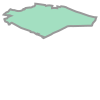

In [346]:
gdf_test1.loc[0,'geometry']

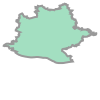

In [347]:
gdf_test1.loc[1,'geometry']

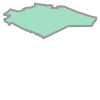

In [348]:
gdf_test2.loc[0,'geometry']

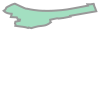

In [349]:
gdf_test2.loc[1,'geometry']

In [350]:
gdf_test1['geometry'].notna()

0    True
1    True
Name: geometry, dtype: bool

In [351]:
gdf_test2['geometry'].notna()

0    True
1    True
Name: geometry, dtype: bool

In [673]:
gdf_test1

NameError: name 'gdf_test1' is not defined

In [353]:
gdf_test2

,index,plz,OBJID_unique,BEGINN_unique,ARS_unique,AGS_unique,GEN_unique,BEZ_unique,note,einwohner,qkm,geometry,bev_dichte,color
0,725,76448,['DEBKGVG200000003'],['2021-07-13'],['082165003009'],['08216009'],['Durmersheim'],['Gemeinde'],76448 Durmersheim,11898,25.922361,"POLYGON ((8.22959 48.93868, 8.2297 48.93856, 8...",458.99,green
1,107,70629,['DEBKGVG20000040K'],['2022-12-20'],['081110000000'],['08111000'],['Stuttgart'],['Stadt'],70629 Stuttgart-Flughafen,8,4.368498,"POLYGON ((9.17903 48.69271, 9.17953 48.69226, ...",1.83,red


In [389]:
gdf_test2.to_json()

OverflowError: Maximum recursion level reached

In [112]:
# fm = folium.Map()

# valid_gdf1 = gdf_test1[gdf_test['geometry'].notna()]  # filter out rows with missing geometries
# valid_gdf2 = gdf_test2[gdf_test['geometry'].notna()]  # filter out rows with missing geometries

# # render the filtered GDF with Folium
# folium.GeoJson(gdf_test1).add_to(fm)
# # folium.GeoJson(gdf_test2).add_to(fm)
# fm

In [113]:
# gj = folium.GeoJson(
#     data=gdf_test2,
#     # nan_fill_opacity=0.1,
#     # style_function=style_fn,
#     # line_color=zone,
#     # highlight_function=highlight_function,
#     tooltip=folium.GeoJsonTooltip(fields=list(dict_tooltip.keys()), 
#     aliases=list(dict_tooltip.values()))
# )

In [114]:
# dict_tooltip = {
#     # 'BEZ_unique' : 'Bezeichnung:',
#     # 'GEN_unique' : 'Geografischer Name',
#     # 'EWZ' : 'Einwohnerzahl:',
#     # 'KFL' : 'Fläche [km2]:',
#     # 'BVD' : 'Bevölkerungsdichte',#[Ew/qkm]',
    
#     # 'einwohner' : 'Einwohnerzahl:',
#     # 'qkm' : 'Fläche [km2]:',
#     # 'bev_dichte' : 'Bevölkerungsdichte:',
    
#     # 'ARS_unique' : 'ARS',
#     'plz' : 'PLZ:',
#     # 'note' : 'Details'
# }

# m_d6_plz_imp = maps.gen_map(
#     pdf=gdf_adm6_plz_imp.loc[0:1],
#     legend_str=legend_str,
#     is_pdf_breakdown=False,
#     col_pdf_breakdown=col_pdf_breakdown,
#     dict_zones = dict_color_inv,
#     # highlight_function=maps.highlight_function,
#     dict_tooltip=dict_tooltip,
#     # logging=logging
# )

# m_d6_plz_imp

# C. GADM `countries`



## SWITZERLAND (Before automation)

In [500]:
path_CHE_adm1 = 'GADM/gadm41_CHE_1.json'
gdf_che_adm1 = gpd.read_file(path_CHE_adm1)
gdf_che_adm1

path_CHE_adm2 = 'GADM/gadm41_CHE_2.json'
gdf_che_adm2 = gpd.read_file(path_CHE_adm2)
# gdf_che_adm2

path_CHE_adm3 = 'GADM/gadm41_CHE_3.json'
gdf_che_adm3 = gpd.read_file(path_CHE_adm3)
# gdf_che_adm3


DataSourceError: GADM/gadm41_CHE_1.json: No such file or directory

In [131]:
gdf_che_adm1

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry
0,CHE.1_1,CHE,Switzerland,Aargau,Argovia|Arg¢via|Argovie,NA,Kanton,Canton,NA,CH.AG,CH-AG,"MULTIPOLYGON (((8.4105 47.1453, 8.4106 47.1443..."
1,CHE.2_1,CHE,Switzerland,AppenzellAusserrhoden,AppenzellAusser-Rhoden|Appenzel,NA,Kanton,Canton,NA,CH.AR,CH-AR,"MULTIPOLYGON (((9.3002 47.259, 9.2963 47.2592,..."
2,CHE.3_1,CHE,Switzerland,AppenzellInnerrhoden,AppenzellInner-Rhoden|Appenzell,NA,Kanton,Canton,NA,CH.AI,CH-AI,"MULTIPOLYGON (((9.3394 47.255, 9.3332 47.2647,..."
3,CHE.4_1,CHE,Switzerland,Basel-Landschaft,Bâle-Campagne|Basel-Country|Base,NA,Kanton,Canton,NA,CH.BL,CH-BL,"MULTIPOLYGON (((7.8026 47.3661, 7.7961 47.3566..."
4,CHE.5_1,CHE,Switzerland,Basel-Stadt,Bâle-Ville|Basel-City|Basel-Town,NA,Kanton,Canton,NA,CH.BS,CH-BS,"MULTIPOLYGON (((7.5843 47.5757, 7.5914 47.5962..."
5,CHE.6_1,CHE,Switzerland,Bern,Berna|Berne,NA,Kanton,Canton,NA,CH.BE,CH-BE,"MULTIPOLYGON (((7.5531 46.4113, 7.5437 46.4109..."
6,CHE.7_1,CHE,Switzerland,Fribourg,Freiburg|Friburg|Friburgo,NA,Canton,Canton,NA,CH.FR,CH-FR,"MULTIPOLYGON (((6.9765 46.4791, 6.9742 46.481,..."
7,CHE.8_1,CHE,Switzerland,Genève,Cenevre|Genebra|Geneve|Geneva|Ge,NA,Canton,Canton,NA,CH.GE,NA,"MULTIPOLYGON (((6.0478 46.1409, 6.0354 46.1362..."
8,CHE.9_1,CHE,Switzerland,Glarus,Glaris|Glarona|Glaruna,NA,Kanton,Canton,NA,CH.GL,CH-GL,"MULTIPOLYGON (((9.0635 46.8732, 9.0488 46.8661..."
9,CHE.10_1,CHE,Switzerland,Graubünden,Graubünden|Grigioni|Grischun|Gri,NA,Kanton,Canton,NA,CH.GR,NA,"MULTIPOLYGON (((9.1584 46.1672, 9.1485 46.1723..."


In [153]:
highlight_function = lambda x: {
    'fillColor': 'red',
    # 'color': 'black',
    # 'lineColor': 'red',
    'fillOpacity': 0.40,
    # 'weight': 0.1
}


tooltip1 = folium.GeoJsonTooltip(
    fields=["ISO_1", "VARNAME_1", "NAME_1"],
    aliases=["HASC_1", "ENGTYPE_1", "TYPE_1"],
    # localize=True,
    # sticky=False,
    # labels=True,
    # style="""
    #     background-color: #F0EFEF;
    #     border: 2px solid black;
    #     border-radius: 3px;
    #     box-shadow: 3px;
    # """,
    # max_width=800,
)

fm = folium.Map()
folium.GeoJson(
    gdf_che_adm1,
    highlight_function=highlight_function,
    tooltip=tooltip1
).add_to(fm)

folium.LayerControl(position='topright',
                    collapsed=False).add_to(fm)

fullscreen = folium.plugins.Fullscreen(position='topleft',
                                       title='Expand me',
                                       title_cancel='Exit me',
                                       force_separate_button=True)
fm.add_child(fullscreen)

fm.fit_bounds(fm.get_bounds())


# fm

# folium.GeoJson(gdf_adm1).add_to(fm)
# fm

In [154]:
highlight_function = lambda x: {
    'fillColor': 'red',
    # 'color': 'black',
    # 'lineColor': 'red',
    'fillOpacity': 0.40,
    # 'weight': 0.1
}


tooltip2 = folium.GeoJsonTooltip(
    fields=["HASC_2", "NAME_2", "NAME_1"],
    aliases=["HASC_2", "TYPE_2", "TYPE_1"],
    # localize=True,
    # sticky=False,
    # labels=True,
    # style="""
    #     background-color: #F0EFEF;
    #     border: 2px solid black;
    #     border-radius: 3px;
    #     box-shadow: 3px;
    # """,
    # max_width=800,
)

fm = folium.Map()
folium.GeoJson(
    gdf_che_adm2,
    highlight_function=highlight_function,
    tooltip=tooltip2
).add_to(fm)

folium.LayerControl(position='topright',
                    collapsed=False).add_to(fm)

fullscreen = folium.plugins.Fullscreen(position='topleft',
                                       title='Expand me',
                                       title_cancel='Exit me',
                                       force_separate_button=True)
fm.add_child(fullscreen)

fm.fit_bounds(fm.get_bounds())


# fm

# folium.GeoJson(gdf_adm1).add_to(fm)
# fm

In [155]:
highlight_function = lambda x: {
    'fillColor': 'red',
    # 'color': 'black',
    # 'lineColor': 'red',
    'fillOpacity': 0.40,
    # 'weight': 0.1
}


tooltip3 = folium.GeoJsonTooltip(
    fields=["NAME_3", "NAME_2", "NAME_1"],
    aliases=["Gemeinde", "Bezirk", "Kanton"],
    # localize=True,
    # sticky=False,
    # labels=True,
    # style="""
    #     background-color: #F0EFEF;
    #     border: 2px solid black;
    #     border-radius: 3px;
    #     box-shadow: 3px;
    # """,
    # max_width=800,
)

fm = folium.Map()
folium.GeoJson(
    gdf_che_adm3,
    highlight_function=highlight_function,
    tooltip=tooltip3
).add_to(fm)

folium.LayerControl(position='topright',
                    collapsed=False).add_to(fm)

fullscreen = folium.plugins.Fullscreen(position='topleft',
                                       title='Expand me',
                                       title_cancel='Exit me',
                                       force_separate_button=True)
fm.add_child(fullscreen)

fm.fit_bounds(fm.get_bounds())


# fm

# folium.GeoJson(gdf_adm1).add_to(fm)
# fm

In [156]:
fm = folium.Map()


gj_che1 = folium.GeoJson(
    gdf_che_adm1,
    # name='CH Kantone',
    highlight_function=highlight_function,
    tooltip=tooltip1
)
fg1 = folium.FeatureGroup(name='CH Kantone')
fg1.add_child(gj_che1)
# fm.add_child(gj_che1)

gj_che2 = folium.GeoJson(
    gdf_che_adm2,
    # name='CH Bezirke',
    highlight_function=highlight_function,
    tooltip=tooltip2
)
fg2 = folium.FeatureGroup(name='CH Bezirke')
fg2.add_child(gj_che2)
# fm.add_child(gj_che2)

gj_che3 = folium.GeoJson(
    gdf_che_adm3,
    # name='CH Gemeinde',
    highlight_function=highlight_function,
    tooltip=tooltip3
)
fg3 = folium.FeatureGroup(name='CH Gemeinde')
fg3.add_child(gj_che3)
# fm.add_child(gj_che3)


fg1.add_to(fm)
fg2.add_to(fm)
fg3.add_to(fm)
# fm.add_child(fg1)
# fm.add_child(fg2)
# fm.add_child(fg3)

folium.LayerControl(position='topright',
                    collapsed=False).add_to(fm)

fullscreen = folium.plugins.Fullscreen(position='topleft',
                                       title='Expand me',
                                       title_cancel='Exit me',
                                       force_separate_button=True)
fm.add_child(fullscreen)

fm.fit_bounds(fm.get_bounds())


fm

In [672]:
###########
# AUSTRIA #
###########

# country_3 = 'AUT'

# path_adm1 = f'GADM/gadm41_{country_3}_1.json'
# gdf_adm1 = gpd.read_file(path_adm1)
# gdf_adm1

# path_adm2 = f'GADM/gadm41_{country_3}_2.json'
# gdf_adm2 = gpd.read_file(path_adm2)
# gdf_adm2

# path_adm3 = f'GADM/gadm41_{country_3}_3.json'
# gdf_adm3 = gpd.read_file(path_adm3)
# # gdf_adm3

# path_adm4 = f'GADM/gadm41_{country_3}_4.json'
# gdf_adm4 = gpd.read_file(path_adm4)
# # gdf_adm4


# tooltip1 = folium.GeoJsonTooltip(
#     fields=["NAME_1"],
#     aliases=[ name_adm1],
# )

# tooltip2 = folium.GeoJsonTooltip(
#     fields=["NAME_2", "NAME_1"],
#     aliases=[ name_adm2, name_adm1],
# )
# tooltip3 = folium.GeoJsonTooltip(
#     fields=["NAME_3", "NAME_2", "NAME_1"],
#     aliases=[name_adm3, name_adm2, name_adm1],
# )

# tooltip4 = folium.GeoJsonTooltip(
#     fields=["NAME_4", "NAME_3", "NAME_2", "NAME_1"],
#     aliases=[name_adm4, name_adm3, name_adm2, name_adm1],
# )
# l_tooltip = [tooltip1,tooltip2,tooltip3,tooltip4]

# print(l_tooltip_adm[0].fields)
# print(l_tooltip_adm[0].aliases)

# print(l_tooltip_adm[1].fields)
# print(l_tooltip_adm[1].aliases)

# print(l_tooltip_adm[2].fields)
# print(l_tooltip_adm[2].aliases)

# print(l_tooltip_adm[3].fields)
# print(l_tooltip_adm[3].aliases)

## ALL COUNTRIES (Automated|)

In [6]:
import f_maps

In [122]:
path = 'assets/Geo/GADM/gadm41_'
country_3 = 'ven'
# country_3 = 'CHE' # Switzerland
# country_3 = 'ESP' # Spain
# country_3 = 'AUT' # Austria
# country_3 = 'GER' # Germany
ext = 'json'

l_levels= [
    # 0, # NOT IMPLEMENTED
    1,
    2,
    # 3,
    # 4
]


In [66]:
logging = True

In [67]:
pwd

'C:\\Code\\ditto_v2'

In [68]:
l_gdf = []
l_name_adm = []
l_tooltip = []

l_field = []
l_alias = []

l_field_ini = []
l_alias_ini = []

for level in l_levels:
    if logging:
        print(f' level={level}')
    path_adm = f'{path}{country_3}_{level}.{ext}'
    gdf_adm = gpd.read_file(path_adm)
    if logging:
        print(f'  Adding level={level} [{gdf_adm.shape[0]}]')
    l_gdf.append(gdf_adm)

 level=1
  Adding level=1 [25]
 level=2
  Adding level=2 [338]


In [123]:
[l_gdf, l_name_adm, l_tooltip_adm , l_field_adm, l_alias_adm] = f_maps.extract_gdf(
    path=path, 
    country_3 = country_3, 
    ext = ext,
    l_levels= l_levels,
    is_logging = logging
)

 level=1
  Adding level=1 [25]
col_name=TYPE_1
  Extracting name for ADM=1 [['Estado']]
l_field_ini = ['NAME_1'] in tooltip1
l_alias_ini= [['Estado']] to tooltip1
 level=2
  Adding level=2 [338]
col_name=TYPE_2
  Extracting name for ADM=2 [['Municipio', 'WaterBody', 'Islas']]
l_field_ini = ['NAME_1', 'NAME_2'] in tooltip2
l_alias_ini= [['Estado'], ['Municipio', 'WaterBody', 'Islas']] to tooltip2


In [ ]:
fm = gen_maps(
    l_adm=l_levels,
    l_gdf=l_gdf, 
    l_name_adm=l_name_adm,
    # l_tooltip=l_tooltip_right, 
    l_tooltip=l_tooltip_adm, 
)

filename = f'{path}{country_3}_map.html'
print(f'Saving file {filename}')
fm.save(filename)

Adding layers
Full screen
Fitting
Saving file assets/Geo/GADM/gadm41_ven_map.html


In [34]:
path

'assets/Geo/GADM/gadm41_'

In [101]:
path = 'assets/Geo/GADM/gadm41_'
country_3 = 'FRA' # Venezuela
l_layers = [
    'ADM_ADM_0', 
    # 'ADM_ADM_1', 'ADM_ADM_2'
    ]
ext  = 'gpkg'
path_adm = f'{path}{country_3}.{ext}'
path_adm

'assets/Geo/GADM/gadm41_FRA.gpkg'

 layer=ADM_ADM_0 [1]
l_tooltip_adm=[<folium.features.GeoJsonTooltip object at 0x000001FAC11CD460>]


In [120]:
fm = gen_maps(
    l_adm = l_layers,
    l_gdf=l_gdf_adm, 
    l_name_adm=l_name_adm,
    l_tooltip=l_tooltip_adm, 
)

Adding layers
Full screen
Fitting


In [100]:
gdf_adm

,GID_0,COUNTRY,geometry
0,FRA,France,"MULTIPOLYGON (((5.76875 43.0793, 5.76875 43.07..."


In [97]:
gdf_adm

,GID_0,COUNTRY,geometry
0,FRA,France,"MULTIPOLYGON (((5.76875 43.0793, 5.76875 43.07..."


In [ ]:
fm = gen_maps(
    # l_adm=l_levels,
    l_adm = l_layers,
    l_gdf=l_gdf, 
    l_name_adm=l_name_adm,
    l_tooltip=l_tooltip_adm, 
)
filename = f'{path}{country_3}_map.html'

In [38]:
url='https://geodata.ucdavis.edu/gadm/gadm4.1/gpkg/gadm41_VEN.gpkg'

In [ ]:
gdf_adm= gpd.read_file(url)

c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\pyogrio\geopandas.py:261: UserWarning: More than one layer found in 'gadm41_VEN.gpkg': 'ADM_ADM_0' (default), 'ADM_ADM_1', 'ADM_ADM_2'. Specify layer parameter to avoid this warning.
  result = read_func(


In [40]:
gdf_adm

,GID_0,COUNTRY,geometry
0,VEN,Venezuela,"MULTIPOLYGON (((-64.37745 1.38654, -64.39356 1..."


In [42]:
pip install fiona


   ---------------------------------------- 0.0/24.5 MB ? eta -:--:--
   ---------- ----------------------------- 6.6/24.5 MB 15.5 MB/s eta 0:00:02
   ---------------------- ----------------- 13.6/24.5 MB 19.9 MB/s eta 0:00:01
   ---------------------------------------  23.9/24.5 MB 26.5 MB/s eta 0:00:01
   ---------------------------------------  24.4/24.5 MB 26.6 MB/s eta 0:00:01
   ---------------------------------------- 24.5/24.5 MB 21.8 MB/s eta 0:00:00


In [45]:
import fiona

In [ ]:
fiona.listlayers(url)

['ADM_ADM_0', 'ADM_ADM_1', 'ADM_ADM_2']

In [444]:
def extract_gdf_gpkg(path:str, l_levels:list = [1,2,3,4], is_logging:bool=False) :
    l_gdf = []
    l_name_adm = []
    l_tooltip = []
    
    l_field = []
    l_alias = []
    
    l_field_ini = []
    l_alias_ini = []
    name_adm = 'COUNTRY'

    for level in l_levels:
        current_adm = int(level[-1])
        if is_logging:
            print(f' level={level}')
        
        print(f'path={path}')
        gdf_adm = gpd.read_file(path, layer=f'{level}')
        if is_logging:
            print(f'  Adding level={level} [{gdf_adm.shape[0]}]')
        l_gdf.append(gdf_adm)

        # col_name = f'TYPE_{level}'
        # if is_logging:
        #     print(f'col_name={col_name}')
        # name_adm = extract_values(gdf_adm[col_name].drop_duplicates().values)
        # if is_logging:
        #     print(f'  Extracting name for ADM={level} [{name_adm}]')
        # l_name_adm.append(name_adm)

        # if not l_field_ini:
        #     l_field_ini = [f'NAME_{level}']
        # else:
        #     l_field_ini.append(f'NAME_{level}')
        # l_field.append(l_field_ini)
        # if is_logging:
        #     print(f'l_field_ini = {l_field_ini} in tooltip{level}')
            
        # if not l_alias_ini:
        #     l_alias_ini = [name_adm]
        # else:
        #     l_alias_ini.append(name_adm)
        # l_alias.append(l_alias_ini)
        # if is_logging:
        #     print(f'l_alias_ini= {l_alias_ini} to tooltip{level}')
        
        
        # tooltip = folium.GeoJsonTooltip(
        #     fields=l_field_ini.copy(),
        #     # aliases=l_alias_ini.copy(),
        # )
        # l_tooltip.append(tooltip)
        print(f'ADM={current_adm}')
        if (current_adm == 0):
            tooltip=folium.features.GeoJsonTooltip(fields=[name_adm])
        elif (current_adm in [1,2,3,4] ):
            print('yes')
            name_adm = extract_values(gdf_adm[f'TYPE_{current_adm}'].drop_duplicates().values)

            l_int = list(range(1, current_adm + 1))            
            l_columns = ['COUNTRY','GID_0'] + [f'NAME_{i}' for i in l_int] + [f'TYPE_{current_adm}']
            print(f'l_columns={l_columns}')
            tooltip=folium.features.GeoJsonTooltip(fields=l_columns)
        else:
            print('No')
        
        l_name_adm.append(name_adm)
        l_tooltip.append(tooltip)

    return [l_gdf, 
            l_name_adm, 
            l_tooltip,
            # l_field, 
            # l_alias
           ]



def extract_values(col_values):
    name_adm = list(col_values)
    name_adm = [x for x in name_adm if x != 'NA']
    return name_adm

In [445]:
def gen_maps(
    l_adm, 
    l_gdf, 
    l_name_adm,
    l_tooltip, 
    is_logging:bool=False
) -> folium.Map():
    
    fm = folium.Map()
    
    for adm, gdf_adm, name_adm, tooltip_adm in zip(l_adm, l_gdf, l_name_adm, l_tooltip):
    # for adm, gdf_adm, tooltip_adm in zip(l_adm, l_gdf, l_tooltip):
    
        current_adm = int(adm[-1])
        if is_logging:
            print(f'Adding ADM={current_adm} [{gdf_adm.shape[0]}  {name_adm}]')
            # print(f'Adding ADM={adm} [{gdf_adm.shape[0]}]')
            
        gj = folium.GeoJson(
            gdf_adm,
            highlight_function=highlight_function,
            tooltip=tooltip_adm
        )            
        fg = folium.FeatureGroup(name=f'ADM={current_adm} [{gdf_adm.shape[0]} {name_adm}]')
        # fg = folium.FeatureGroup(name=f'ADM={adm} [{gdf_adm.shape[0]}]')
        fg.add_child(gj)
        fg.add_to(fm)
        
    folium.LayerControl(position='topright',
                        collapsed=False).add_to(fm)
    print('Adding layers')
    fullscreen = folium.plugins.Fullscreen(position='topleft',
                                           title='Expand me',
                                           title_cancel='Exit me',
                                           force_separate_button=True)
    fm.add_child(fullscreen)
    print('Full screen')
    
    fm.fit_bounds(fm.get_bounds())
    print('Fitting')
    
    
    return fm


In [446]:
path = 'assets/Geo/GADM/gadm41_'
country_3 = 'VEN' # Venezuela
l_adm = [
    'ADM_ADM_0', 
    'ADM_ADM_1', 
    'ADM_ADM_2',
    # 'ADM_ADM_3',
    # 'ADM_ADM_4',
    # 'ADM_ADM_5',
    ]
ext  = 'gpkg'
path_adm = f'{path}{country_3}.{ext}'
path_adm

[l_gdf, 
 l_name_adm, 
l_tooltip_adm , 
# l_field_adm, 
# l_alias_adm
] = extract_gdf_gpkg(
    path=path_adm, 
    l_levels= l_adm,
    is_logging = logging
)

 level=ADM_ADM_0
path=assets/Geo/GADM/gadm41_VEN.gpkg
  Adding level=ADM_ADM_0 [1]
ADM=0
 level=ADM_ADM_1
path=assets/Geo/GADM/gadm41_VEN.gpkg
  Adding level=ADM_ADM_1 [25]
ADM=1
yes
l_columns=['COUNTRY', 'GID_0', 'NAME_1', 'TYPE_1']
 level=ADM_ADM_2
path=assets/Geo/GADM/gadm41_VEN.gpkg
  Adding level=ADM_ADM_2 [338]
ADM=2
yes
l_columns=['COUNTRY', 'GID_0', 'NAME_1', 'NAME_2', 'TYPE_2']


In [462]:
l_adm

['ADM_ADM_0', 'ADM_ADM_1', 'ADM_ADM_2']

In [499]:
fm = gen_maps(
    l_adm=l_adm,
    l_gdf=l_gdf, 
    l_name_adm=l_name_adm,
    # l_tooltip=l_tooltip_right, 
    l_tooltip=l_tooltip_adm, 
    is_logging=True
)
# fm


Adding ADM=0 [1  COUNTRY]
Adding layers
Full screen
Fitting


In [424]:
# filename = f'{path}{country_3}_map.html'
# print(f'Saving file {filename}')
fm.save(filename)

In [425]:

url

'https://geodata.ucdavis.edu/gadm/gadm4.1/gpkg/gadm41_FRA.gpkg'

In [433]:
import requests

def download_gpkg_country(country_ISO_3):
    url=f'https://geodata.ucdavis.edu/gadm/gadm4.1/gpkg/gadm41_{country_ISO_3}.gpkg'
    local_filename = f'assets/Geo/GADM/gadm41_{country_ISO_3}.gpkg'

    # Send a GET request to the URL
    with requests.get(url, stream=True) as response:
        response.raise_for_status()  # Check if the request was successful

        # Open a local file with write-binary mode
        with open(local_filename, 'wb') as file:
            # Write the content to the local file in chunks
            for chunk in response.iter_content(chunk_size=8192):
                file.write(chunk)
    print(f"File downloaded as {local_filename}")

    # Example usage
    # download_file(url, local_filename)
    return local_filename

In [485]:
country_3 = 'USA'

In [491]:
local_filename = download_gpkg_country(country_3)
fiona.listlayers(local_filename)

print(local_filename)


l_adm = ['ADM_ADM_0']
# l_adm = ['ADM_ADM_0', 'ADM_ADM_1']
# l_adm = ['ADM_ADM_0', 'ADM_ADM_1', 'ADM_ADM_2']
# l_adm = ['ADM_ADM_0', 'ADM_ADM_1', 'ADM_ADM_2'], 'ADM_ADM_3']

print(local_filename)
print(l_adm)

File downloaded as assets/Geo/GADM/gadm41_USA.gpkg
assets/Geo/GADM/gadm41_USA.gpkg
assets/Geo/GADM/gadm41_USA.gpkg
['ADM_ADM_0']


In [492]:
[l_gdf, l_name_adm, l_tooltip_adm] = extract_gdf_gpkg(
    path=local_filename, 
    l_levels= l_adm,
    is_logging = logging
)

 level=ADM_ADM_0
path=assets/Geo/GADM/gadm41_USA.gpkg
  Adding level=ADM_ADM_0 [1]
ADM=0


In [497]:
print(len(l_gdf))
print(len(l_adm))

print(len(l_name_adm))
print(len(l_tooltip_adm))


fm = gen_maps(
    l_adm=l_adm,
    l_gdf=l_gdf, 
    l_name_adm=l_name_adm,
    l_tooltip=l_tooltip_adm, 
    is_logging=logging
)
# fm

1
1
1
1
Adding ADM=0 [1  COUNTRY]
Adding layers
Full screen
Fitting


In [498]:
adm_list = ''.join([x[-1] for x in l_adm])
filename = f'{path}{country_3}_adm_{adm_list}_map.html'
print(f'Saving file {filename}')
fm.save(filename)

Saving file assets/Geo/GADM/gadm41_USA_adm_0_map.html
